In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip3 install h5py
!pwd

/content


In [ ]:
import os
import csv
import cv2
import ast
import numpy as np
import pandas as pd
from glob import glob
from tqdm import tqdm
from PIL import Image, ImageDraw
!pip install "dask[bag]"
from dask import bag
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.metrics import top_k_categorical_accuracy
import matplotlib.pyplot as plt
import matplotlib.style as style
%matplotlib inline
from keras.backend import clear_session
from keras.layers import Activation, Reshape
from keras.models import Sequential, Model
from keras.layers import Input, Dense, BatchNormalization, Dropout, Flatten
from keras.layers import Conv2D, Conv2DTranspose, UpSampling2D, Reshape, Flatten
from keras.layers.advanced_activations import LeakyReLU
from keras.optimizers import Adam, SGD
from keras.initializers import RandomNormal
from keras.backend import clear_session
from keras.models import load_model

np.random.seed(0)
class_paths = glob('/content/drive/My Drive/AI/input/train/*.csv')
class_paths2 = pd.read_csv('/content/drive/My Drive/AI/input/generator_input.csv')
numstonames = {i: v[39:-4].replace(" ", "_") for i, v in enumerate(class_paths)}
print(numstonames)
namestonums = {v:k for k,v in numstonames.items()}

     |████████████████████████████████| 102kB 7.4MB/s 
  Created wheel for locket: filename=locket-0.2.0-cp36-none-any.whl size=4042 sha256=f67d92bb8643b2daa3de85829f309c9366a703218af15dfd3bc921753bf95336
  Stored in directory: /root/.cache/pip/wheels/26/1e/e8/4fa236ec931b1a0cdd61578e20d4934d7bf188858723b84698
Successfully built locket
{0: 'ear', 1: 'diamond', 2: 'clock', 3: 'airplane', 4: 'camera', 5: 'door', 6: 'hammer', 7: 'cake', 8: 'bird', 9: 'ladder', 10: 'butterfly', 11: 'bicycle', 12: 'computer', 13: 'hat', 14: 'bee', 15: 'hamburger', 16: 'guitar', 17: 'cat', 18: 'leaf', 19: 'pencil', 20: 'chair', 21: 'star', 22: 'shoe', 23: 'sword', 24: 'scissors', 25: 'lion', 26: 'rabbit', 27: 'The_Eiffel_Tower', 28: 'hand', 29: 'tree'}


In [ ]:
for i in class_paths2:
  print(i)

computer
guitar
hamburger
hammer
lion
scissors
sword
star
pencil
rabbit


In [ ]:
def draw_it(strokes):
  image = Image.new("P", (256,256), color=255)
  image_draw = ImageDraw.Draw(image)
  for stroke in ast.literal_eval(strokes):
    for i in range(len(stroke[0])-1):
      image_draw.line([stroke[0][i],
                       stroke[1][i],
                       stroke[0][i+1],
                       stroke[1][i+1]],
                       fill=0, width=5)
  image = image.resize((imheight, imwidth))
  return 255-np.array(image)

In [ ]:
class DCGAN():
  def __init__(self):
      self.img_rows = imheight
      self.img_cols = imwidth
      self.img_shape = (self.img_rows, self.img_cols, 1)
      self.latent_dim = 100
      self.optimizer = Adam(lr=0.0002, beta_1=0.5, decay=8e-8)

      # Build and compile the discriminator
      self.discriminator = self.build_discriminator()
      self.discriminator.compile(loss='binary_crossentropy', optimizer=self.optimizer)

      # Build and compile the generator
      self.generator = self.build_generator()
      self.generator.compile(loss='binary_crossentropy', optimizer=self.optimizer)
      self.gan = self.build_GAN()

  def build_GAN(self):
      self.discriminator.trainable = False
      gan_input = Input(shape=(self.latent_dim,))
      img = self.generator(gan_input)
      gan_output = self.discriminator(img)
      gan = Model(gan_input, gan_output, name='GAN')
      gan.compile(loss='binary_crossentropy', optimizer=self.optimizer)
      gan.summary()
      return gan

  def build_generator(self):
      generator = Sequential()
      generator.add(Dense(128 * 16 * 16, activation="relu", input_dim=self.latent_dim))
      generator.add(Reshape((16, 16, 128)))
      generator.add(BatchNormalization(momentum=0.8))
      generator.add(UpSampling2D())
      generator.add(Conv2D(128, kernel_size=3, padding="same"))
      generator.add(LeakyReLU(0.2))
      generator.add(BatchNormalization(momentum=0.8))
      generator.add(UpSampling2D())
      generator.add(Conv2D(64, kernel_size=3, padding="same"))
      generator.add(LeakyReLU(0.2))
      generator.add(BatchNormalization(momentum=0.8))

      generator.add(Conv2D(1, kernel_size=3, padding='same', activation = "tanh"))
      generator.summary()
      noise = Input(shape=(self.latent_dim,))
      img = generator(noise)
      return Model(noise, img, name='Generator')

  def build_discriminator(self):
      discriminator = Sequential()
      discriminator.add(Conv2D(64, kernel_size=(5, 5), strides=(2, 2), padding='same',
                               input_shape=self.img_shape, kernel_initializer=RandomNormal(stddev=0.02)))
      discriminator.add(LeakyReLU(0.2))
      discriminator.add(Dropout(0.05))
      discriminator.add(Conv2D(128, kernel_size=(5, 5), strides=(2, 2), padding='same'))
      discriminator.add(LeakyReLU(0.2))
      discriminator.add(Dropout(0.05))

      discriminator.add(Conv2D(256, kernel_size=(5, 5), strides=(2, 2), padding='same'))
      discriminator.add(LeakyReLU(0.2))
      discriminator.add(Dropout(0.2))

      discriminator.add(Flatten())
      discriminator.add(Dense(1, activation='sigmoid'))
      discriminator.summary()
      img = Input(shape=self.img_shape)
      validity = discriminator(img)
      return Model(img, validity, name='Discriminator')


  def train(self, X_train, epochs, batch_size=128, sample_interval=50):
      ##self.generator = load_model(generator_path)
      ##self.discriminator = load_model(discriminator_path)
      real = np.ones((batch_size, 1))
      fake = np.zeros((batch_size, 1))
      avg_losses = {'D': [], 'G': []}
      num_batches = len(X_train) // batch_size
      for epoch in range(epochs):
          d_loss_acc = 0
          g_loss_acc = 0
          for i in range(num_batches):
            #Random batch of real doodles
            imgs = X_train[np.random.randint(0, len(X_train) - 1, batch_size)]
            #Generate a batch of doodles
            noise = np.random.normal(0, 1, (batch_size, self.latent_dim))
            gen_imgs = self.generator.predict(noise)
            self.discriminator.trainable = True
            #Train the discriminator (add random smoothing to labels)
            d_loss_real = self.discriminator.train_on_batch(imgs, real * (np.random.uniform(0.7, 1.2)))
            d_loss_fake = self.discriminator.train_on_batch(gen_imgs, fake + (np.random.uniform(0.0, 0.3)))
            d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)
            #We don't want the discriminator to get updated while the generator is being trained
            self.discriminator.trainable = False
            #Train the generator
            g_loss = self.gan.train_on_batch(noise, real)
            d_loss_acc += d_loss
            g_loss_acc += g_loss
          if (epoch + 1) % sample_interval == 0 or epoch == 0:
              self.sample_images(epoch)
          if (epoch + 1) % 3 == 0 or epoch == 0:
              self.generator.save(generator_path)
              self.discriminator.save(discriminator_path)

          avg_losses['D'].append(d_loss_acc/num_batches)
          avg_losses['G'].append(g_loss_acc/num_batches)
      self.plot_loss(avg_losses)

  def sample_images(self, epoch):
    num_examples = 100
    random_noise = np.random.normal(0, 1, size=[num_examples, self.latent_dim])
    generated_images = self.generator.predict(random_noise)
    generated_images = generated_images.reshape(num_examples, 64, 64)*127.5 + 1
    plt.figure(figsize=(10, 10))
    for i in range(generated_images.shape[0]):
        plt.subplot(10, 10, i+1)
        plt.imshow(generated_images[i], interpolation='nearest', cmap='gray_r')
        plt.axis('off')
    plt.suptitle("Samples from G - Epoch = " + str(epoch+1))
    plt.show()

  def plot_loss(self, losses):
      plt.figure(figsize=(10, 8))
      plt.plot(losses["D"], label="Discriminator loss")
      plt.plot(losses["G"], label="Generator loss")
      plt.xlabel('Epochs')
      plt.ylabel('Loss')
      plt.legend()
      plt.title("Loss History")
      plt.show()

In [ ]:
def csvWriter(file_name, nparray):
  example = nparray.tolist()
  with open(file_name+'.csv', 'w', newline='') as csvfile:
    writer = csv.writer(csvfile, delimiter=',')
    writer.writerows(example)

def save_images(grapharray):
  grapharray = np.reshape(grapharray, (64, 64))
  plt.figure(figsize=(16, 16))
  plt.imshow(grapharray, interpolation='nearest', cmap='gray_r')
  plt.axis('off')

  plt.savefig(output_image_dir + image_label + "/" + image_label + "_{:04d}.png".format(i) )
  csvWriter(output_csv_dir + image_label + "/" + image_label + "_{:04d}".format(i), grapharray)
def top_3_accuracy(x,y):
  t3 = top_k_categorical_accuracy(x,y, 3)
  return t3

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_6 (Conv2D)            (None, 32, 32, 64)        1664      
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 32, 32, 64)        0         
_________________________________________________________________
dropout_3 (Dropout)          (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 16, 16, 128)       204928    
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 16, 16, 128)       0         
_________________________________________________________________
dropout_4 (Dropout)          (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 8, 8, 256)        

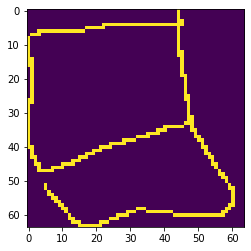

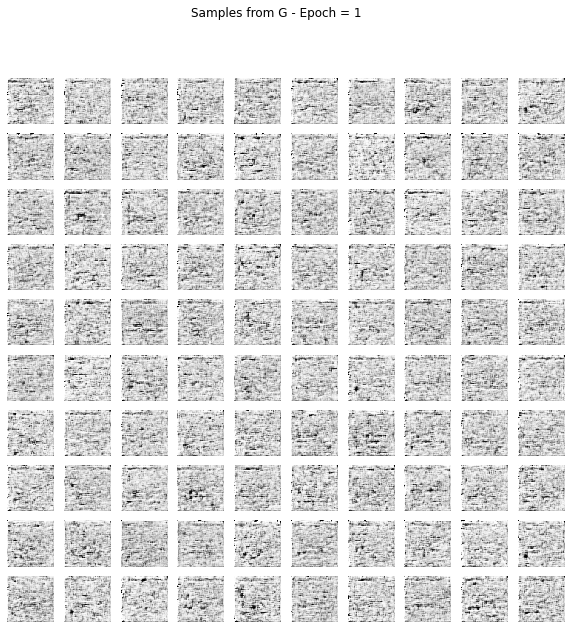

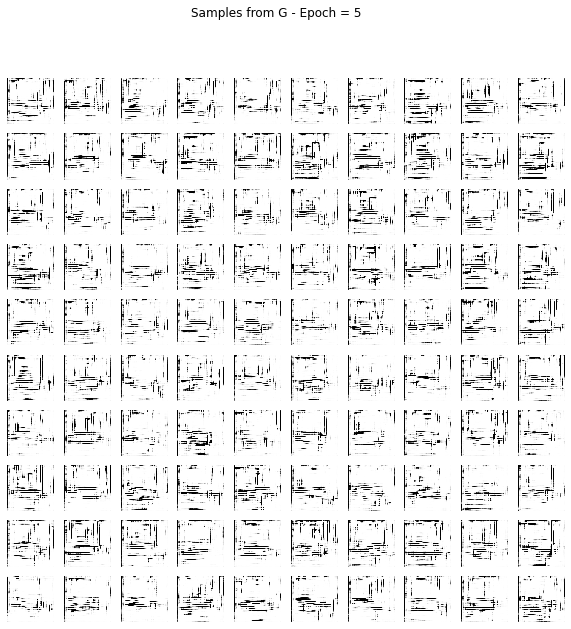

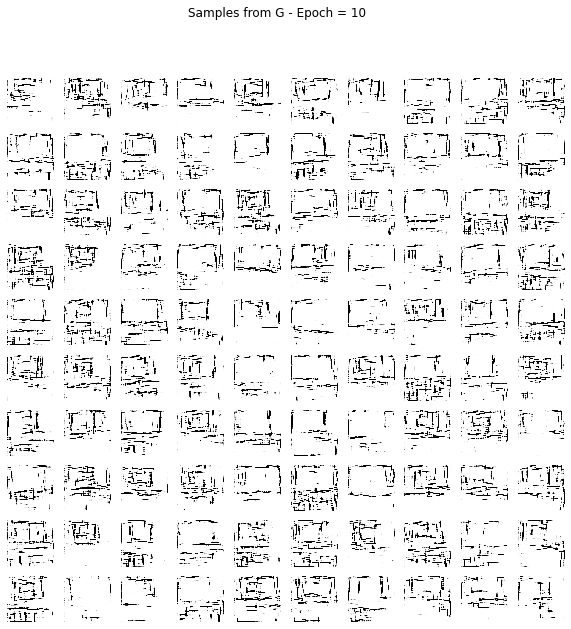

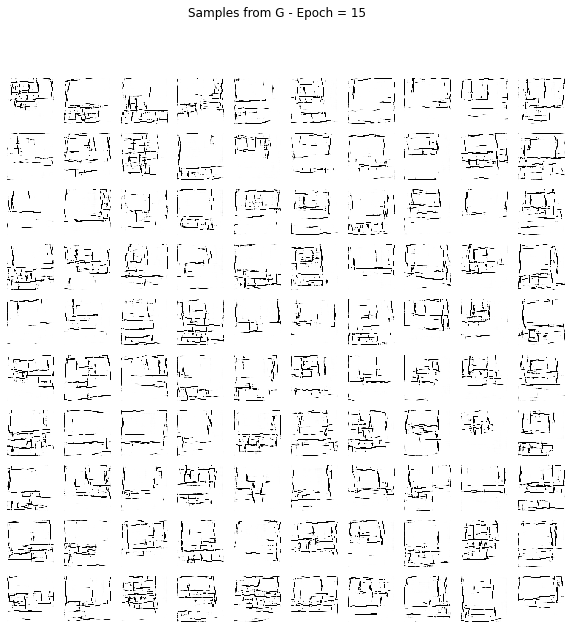

...

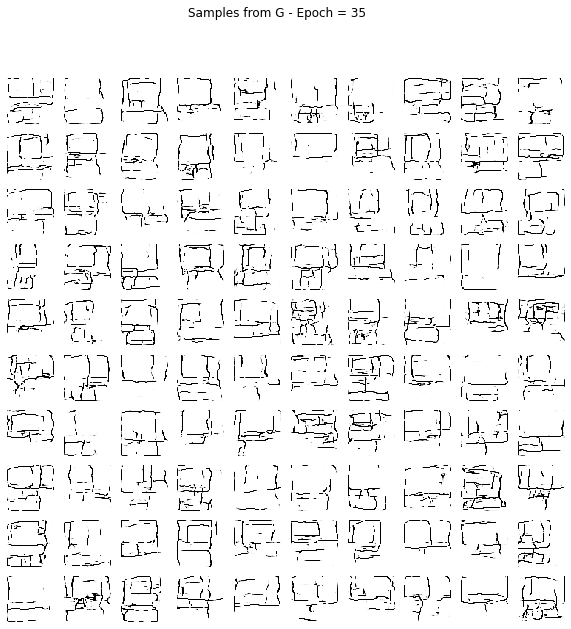

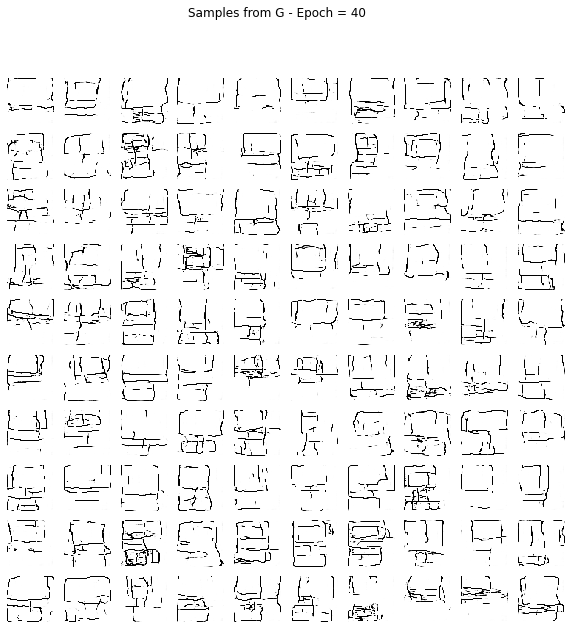

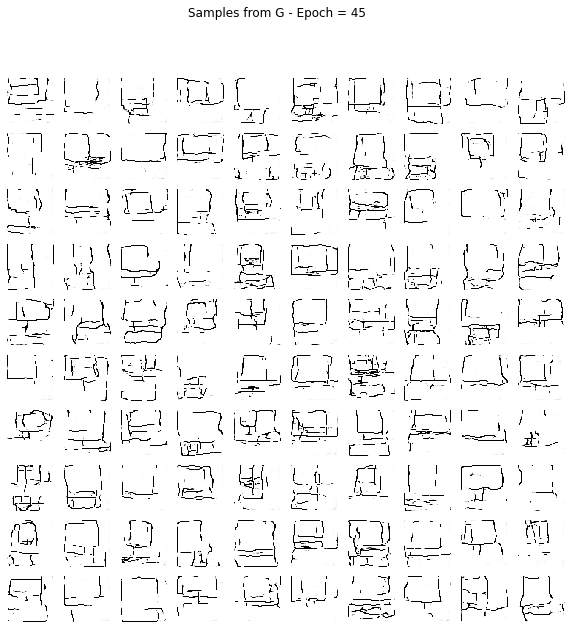

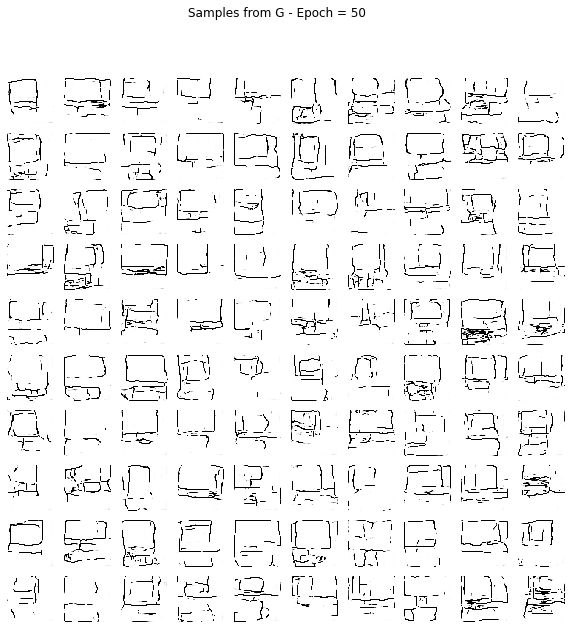

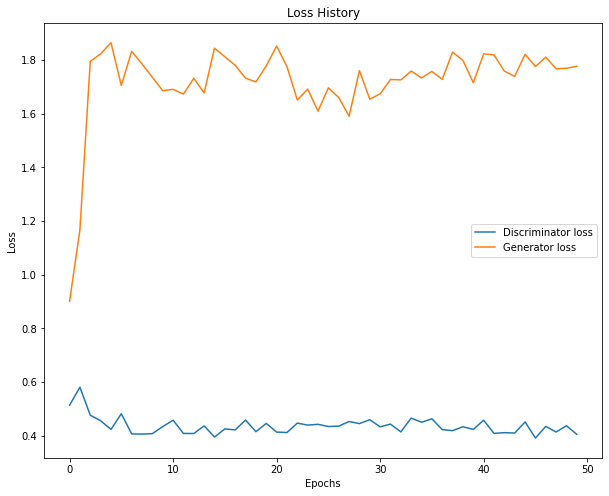

computer
fail
fail
computer chair door
fail
fail
computer chair ladder
fail
fail
computer hamburger cake
fail
fail
computer chair hat
fail
fail
computer door hat
fail
fail
computer camera cake
fail
fail
computer hamburger door
fail
fail
computer hat chair
fail
fail
computer hamburger chair
fail
fail
computer door chair
fail
fail
computer chair hat
fail
fail
computer door chair
fail
fail
computer chair hamburger
fail
fail
computer door chair
fail
fail
computer hamburger chair
fail
fail
computer chair tree
fail
fail
computer hat door
fail
fail
computer door chair
fail
fail
computer door chair
fail
fail
chair sword cake
fail
fail
computer door camera


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


fail
fail
computer chair door
fail
fail
computer chair door
fail
fail
computer chair hamburger
fail
fail
computer cake camera
fail
fail
computer chair shoe
fail
fail
computer hamburger cake
fail
fail
computer door chair
fail
fail
computer door chair
fail
fail
computer hamburger cake
fail
fail
computer chair hamburger
fail
fail
computer door camera
fail
fail
computer chair door
fail
fail
computer door camera
fail
fail
computer cake door
fail
fail
computer chair door
fail
fail
computer chair hat
fail
fail
computer hat camera
fail
fail
computer ladder hamburger
fail
fail
computer chair door
fail
fail
computer hat door
fail
fail
computer chair shoe
fail
fail
computer camera door
fail
fail
computer chair hat
fail
fail
computer door cake
fail
fail
computer hamburger cake
fail
fail
computer chair door
fail
fail
computer camera door
fail
fail
computer chair ladder
fail
fail
computer door camera
fail
fail
computer door chair
fail
fail
computer hamburger shoe
fail
fail
chair hat sword
fail
fail


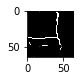

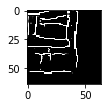

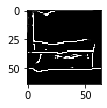

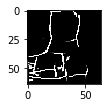

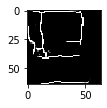

...

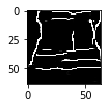

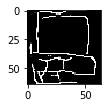

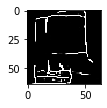

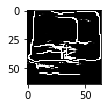

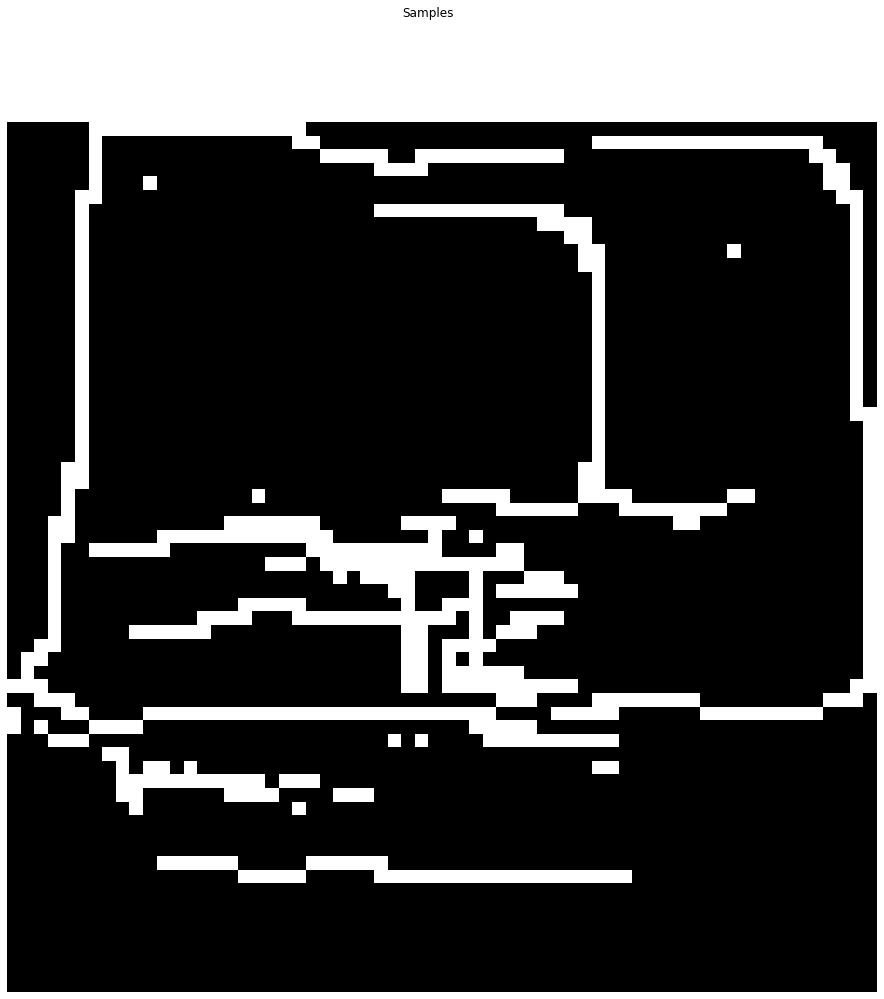

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_12 (Conv2D)           (None, 32, 32, 64)        1664      
_________________________________________________________________
leaky_re_lu_10 (LeakyReLU)   (None, 32, 32, 64)        0         
_________________________________________________________________
dropout_6 (Dropout)          (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 16, 16, 128)       204928    
_________________________________________________________________
leaky_re_lu_11 (LeakyReLU)   (None, 16, 16, 128)       0         
_________________________________________________________________
dropout_7 (Dropout)          (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 8, 8, 256)        

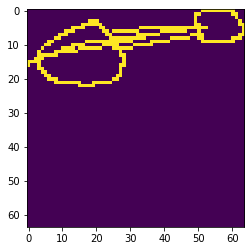

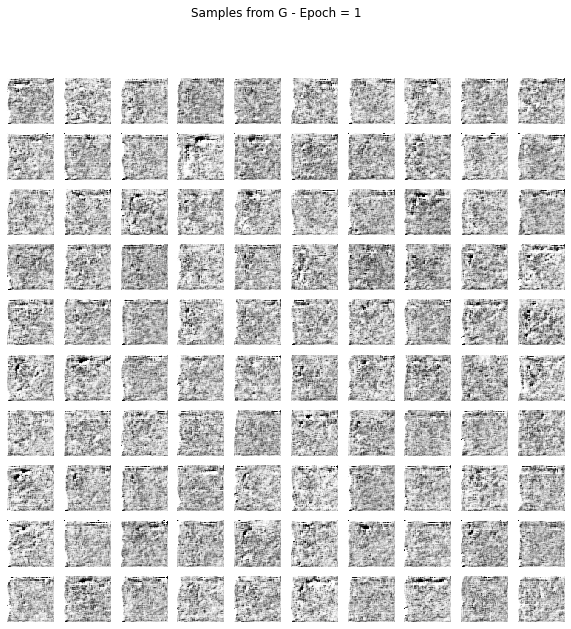

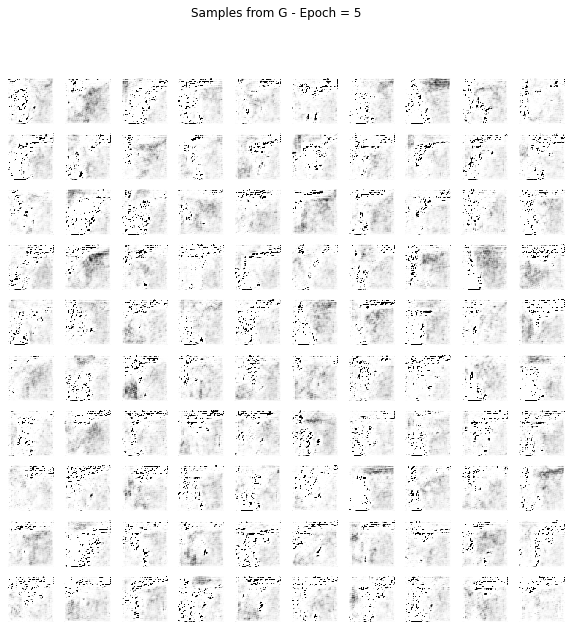

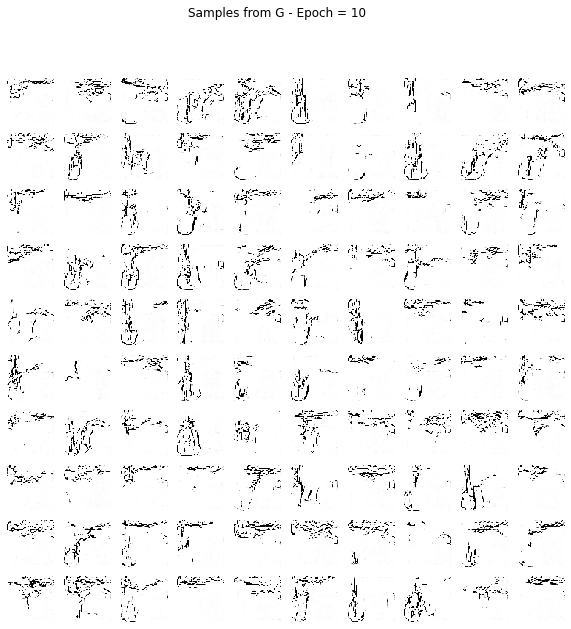

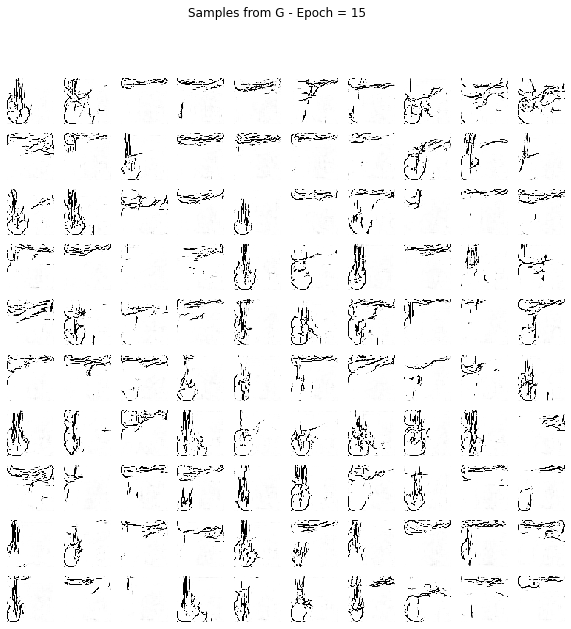

...

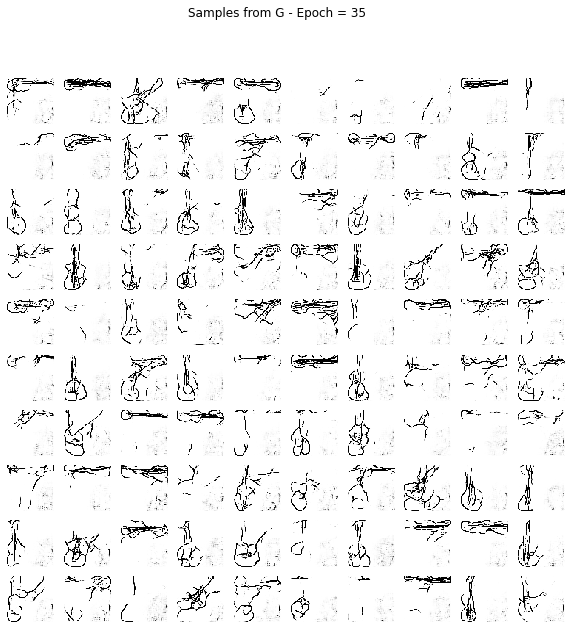

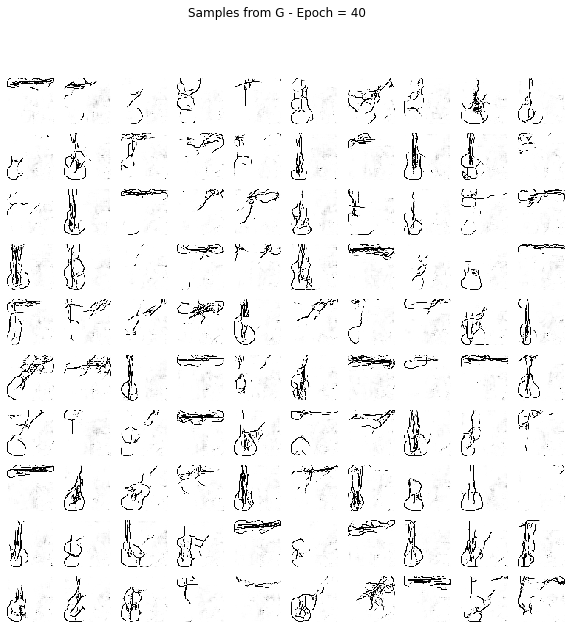

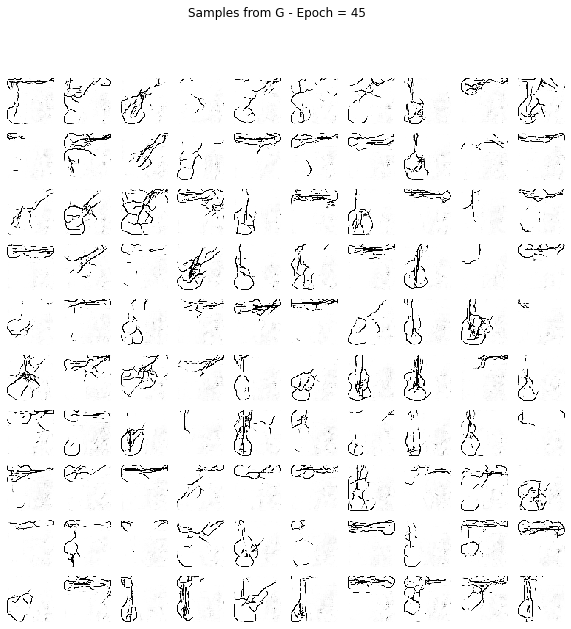

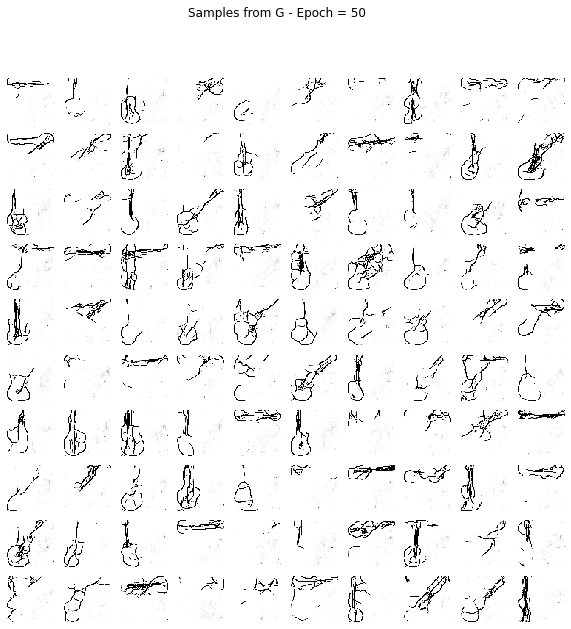

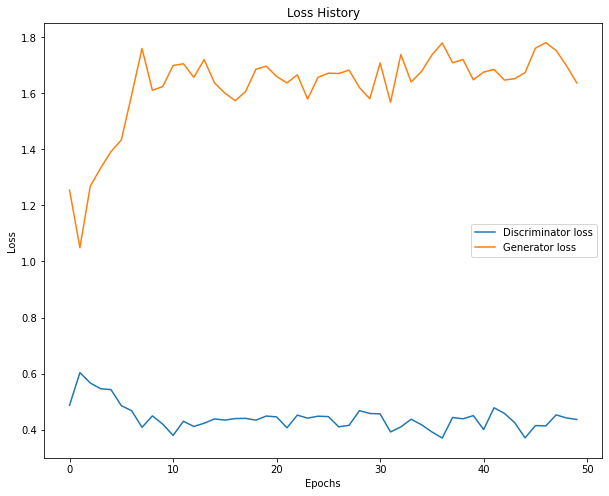

guitar
fail
fail
guitar bird cat
fail
fail
guitar cat bird
fail
fail
guitar scissors ear
fail
fail
rabbit guitar ear
fail
fail
guitar ear bird
fail
fail
guitar tree bird
fail
fail
guitar scissors ear
fail
fail
guitar bicycle cat
fail
fail
guitar ear scissors
fail
fail
guitar bird chair
fail
fail
bird cat tree
fail
fail
guitar scissors The_Eiffel_Tower
fail
fail
bird cat airplane
fail
fail
guitar hamburger airplane
fail
fail
guitar scissors cat
fail
fail
hammer guitar tree
fail
fail
guitar leaf bird
fail
fail
guitar airplane cat
fail
fail
bird ear tree
fail
fail
bird tree butterfly
fail
fail
guitar scissors rabbit
fail
fail
guitar scissors hamburger
fail
fail
guitar tree scissors
fail
fail
guitar rabbit scissors
fail
fail
guitar rabbit scissors
fail
fail
guitar ear leaf
fail
fail
hammer ear leaf
fail
fail
guitar scissors tree
fail
fail
guitar scissors hamburger
fail
fail
guitar bird scissors
fail
fail
cat bee bird
fail
fail
guitar leaf cat
fail
fail
bird guitar bicycle
fail
fail
bird gu

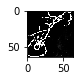

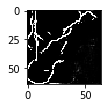

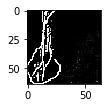

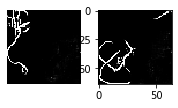

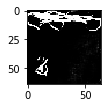

...

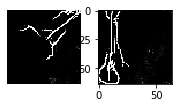

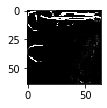

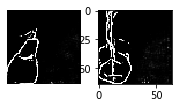

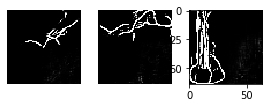

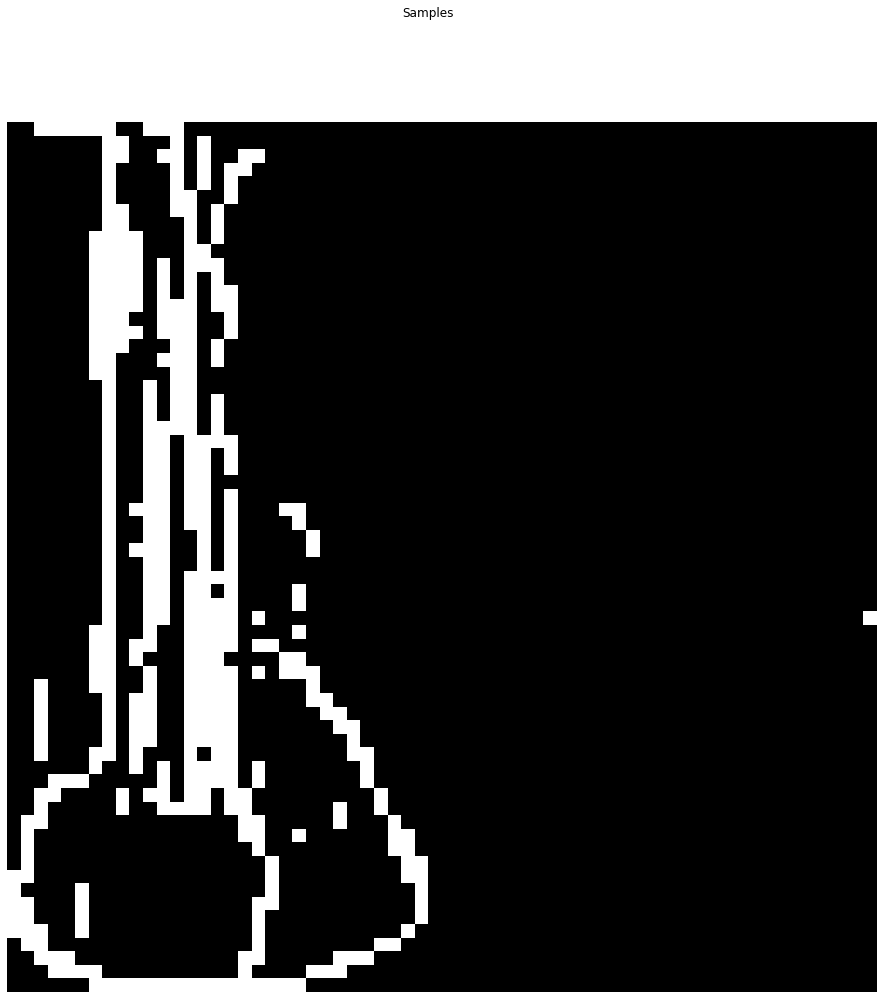

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_18 (Conv2D)           (None, 32, 32, 64)        1664      
_________________________________________________________________
leaky_re_lu_15 (LeakyReLU)   (None, 32, 32, 64)        0         
_________________________________________________________________
dropout_9 (Dropout)          (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_19 (Conv2D)           (None, 16, 16, 128)       204928    
_________________________________________________________________
leaky_re_lu_16 (LeakyReLU)   (None, 16, 16, 128)       0         
_________________________________________________________________
dropout_10 (Dropout)         (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_20 (Conv2D)           (None, 8, 8, 256)        

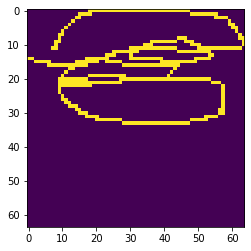

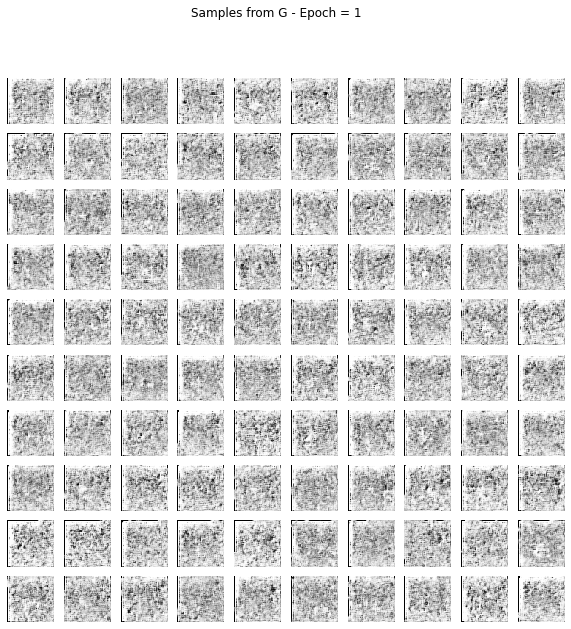

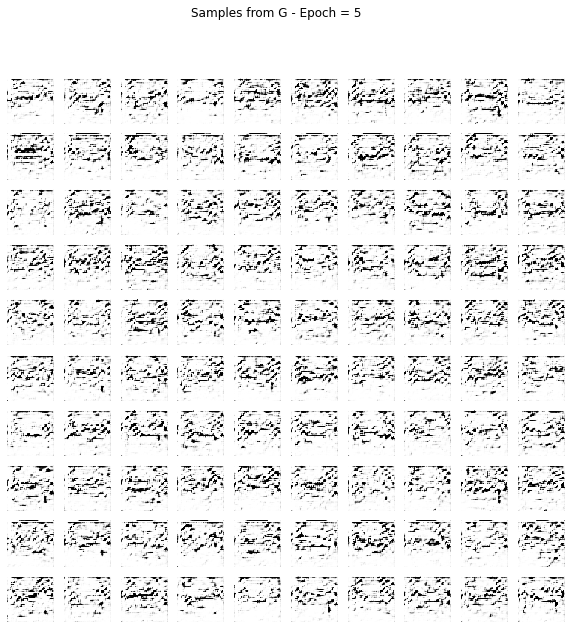

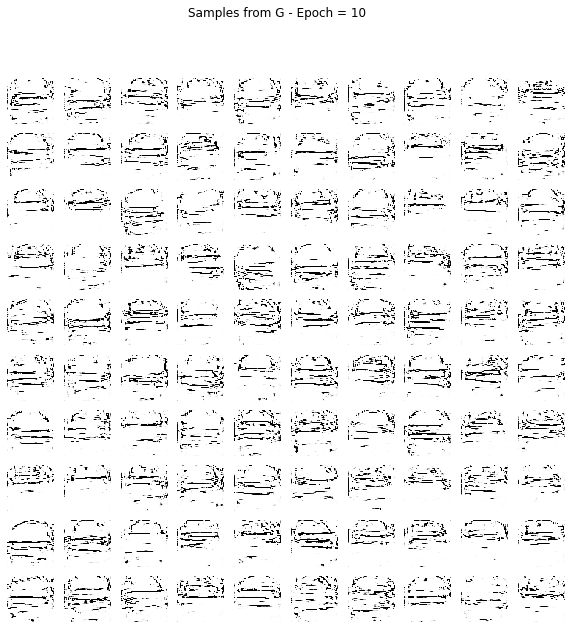

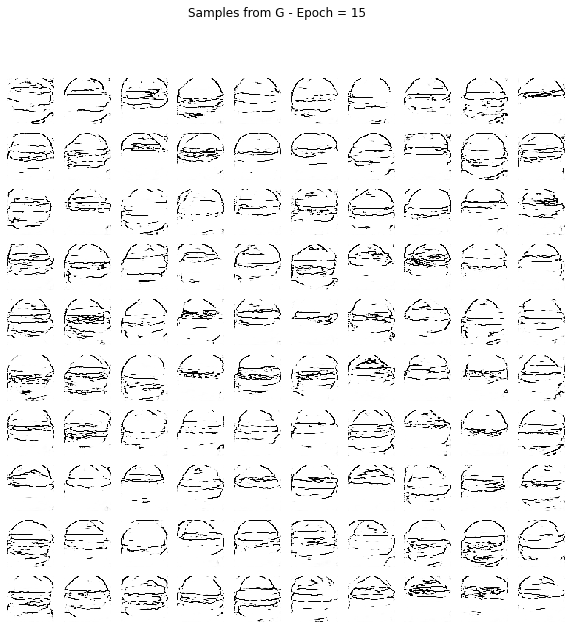

...

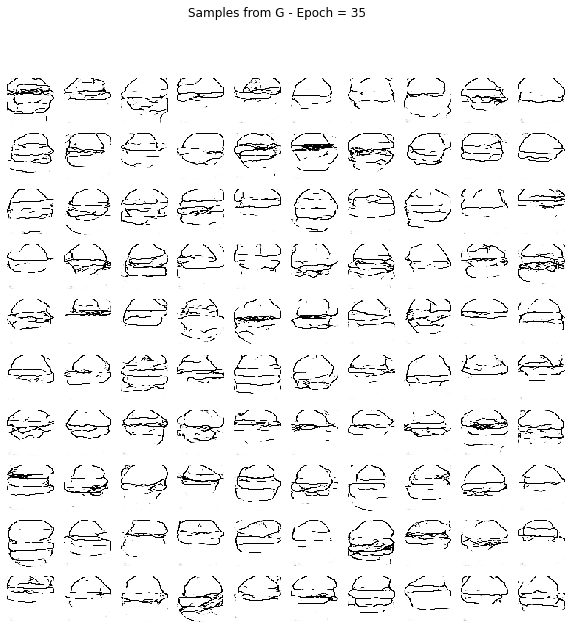

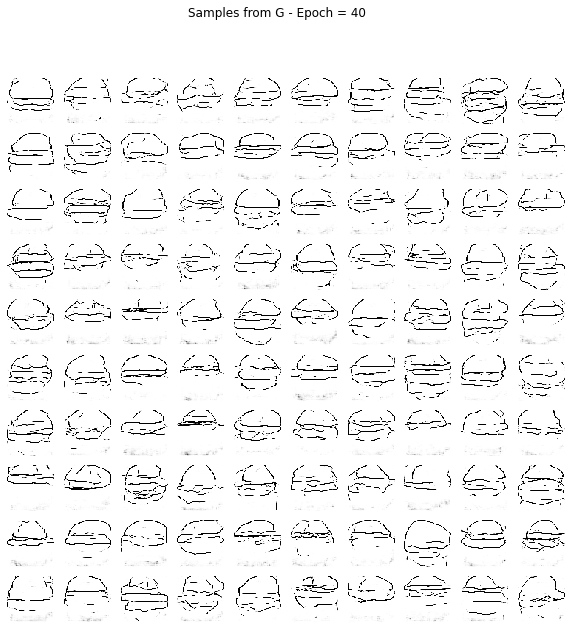

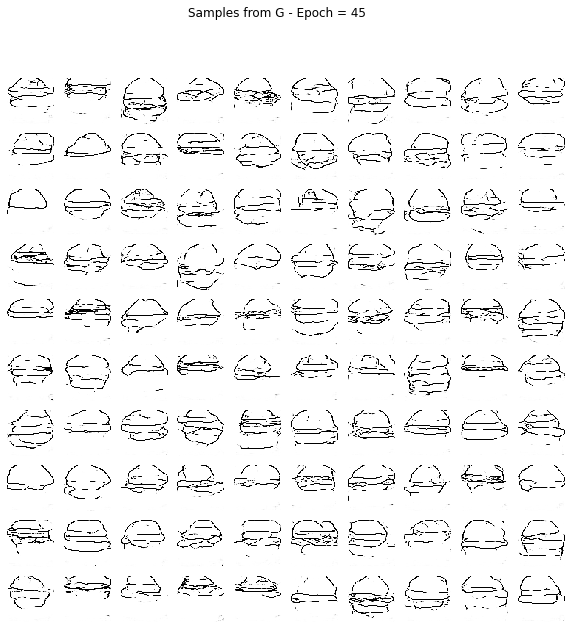

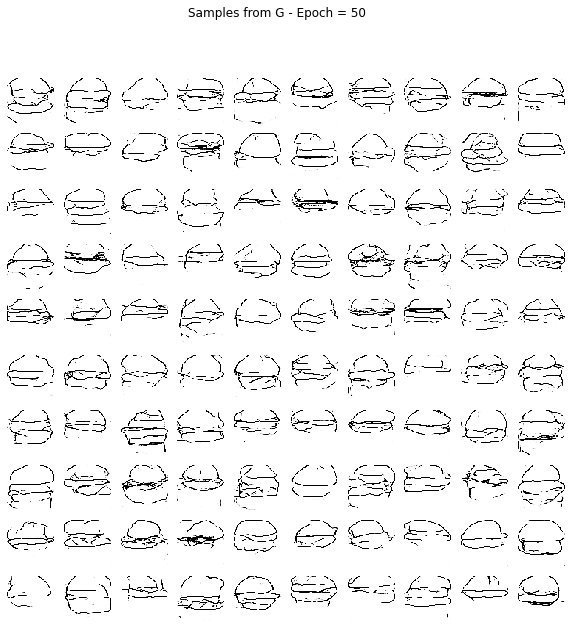

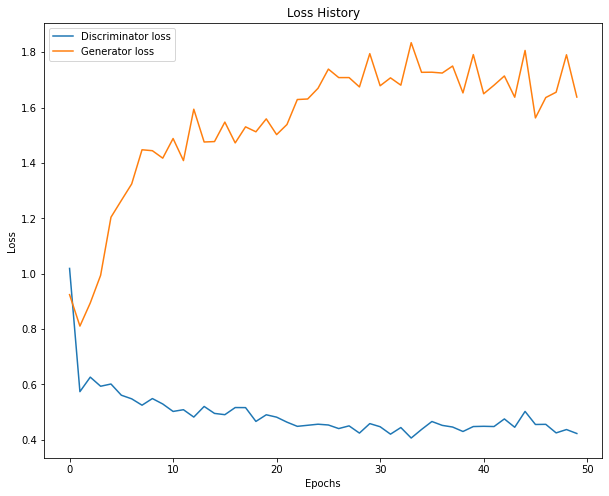

hamburger
fail
fail
hamburger computer cake
fail
fail
hamburger hat computer
fail
fail
hamburger hat computer
fail
fail
hamburger hat computer
fail
fail
hamburger cat computer
fail
fail
hamburger cat lion
fail
fail
hamburger computer hat
fail
fail
hamburger cake hat
fail
fail
hamburger hat computer
fail
fail
hamburger diamond computer
fail
fail
hamburger hat cake
fail
fail
hamburger cake computer
fail
fail
hamburger cake computer
fail
fail
hamburger hat computer
fail
fail
hamburger cat hat
fail
fail
hamburger airplane cat
fail
fail
hamburger cake hat
fail
fail
hamburger hat computer
fail
fail
hamburger hat computer
fail
fail
hamburger computer cake
fail
fail
hamburger computer cake
fail
fail
cat hamburger lion
fail
fail
hamburger computer cake
fail
fail
hamburger hat computer
fail
fail
hamburger cat computer
fail
fail
hamburger hat cake
fail
fail
hamburger hat computer
fail
fail
hamburger airplane hat
fail
fail
hamburger computer cake
fail
fail
hamburger cake cat
fail
fail
hamburger bi

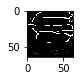

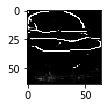

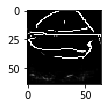

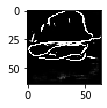

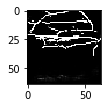

...

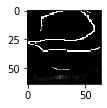

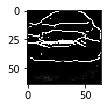

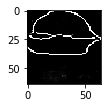

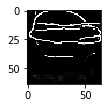

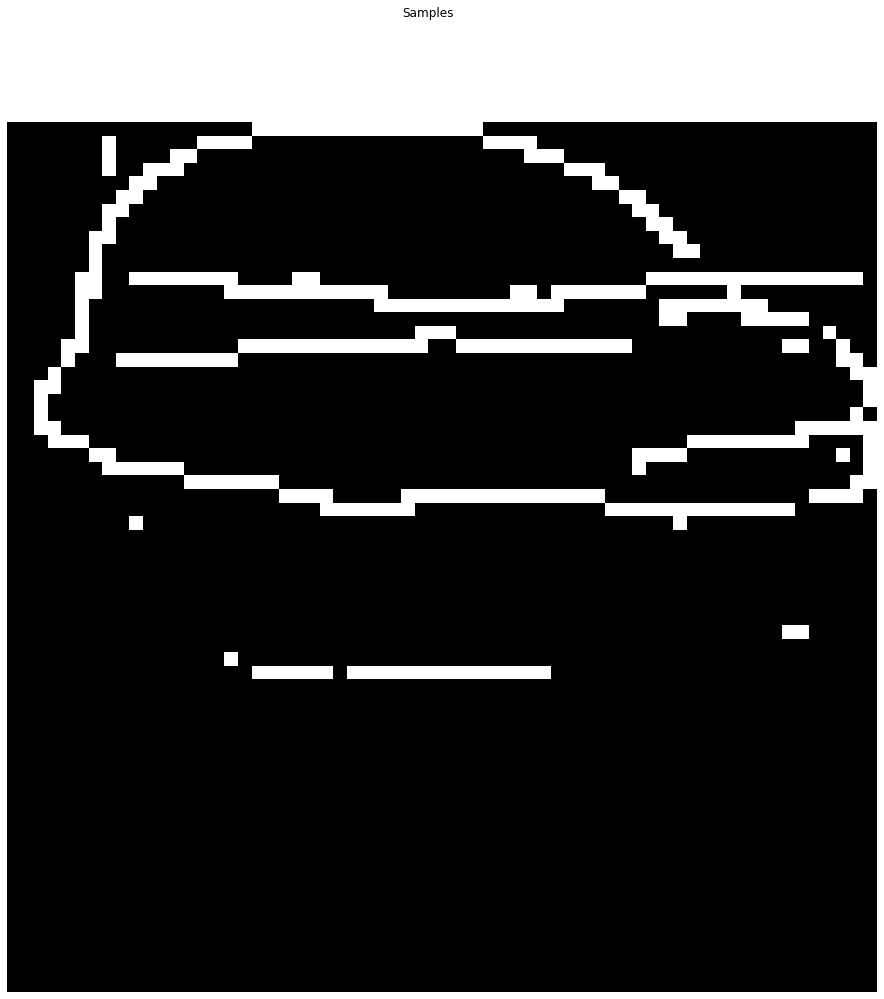

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_24 (Conv2D)           (None, 32, 32, 64)        1664      
_________________________________________________________________
leaky_re_lu_20 (LeakyReLU)   (None, 32, 32, 64)        0         
_________________________________________________________________
dropout_12 (Dropout)         (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_25 (Conv2D)           (None, 16, 16, 128)       204928    
_________________________________________________________________
leaky_re_lu_21 (LeakyReLU)   (None, 16, 16, 128)       0         
_________________________________________________________________
dropout_13 (Dropout)         (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_26 (Conv2D)           (None, 8, 8, 256)        

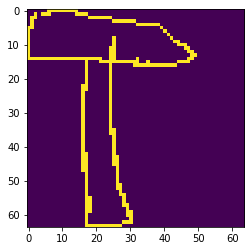

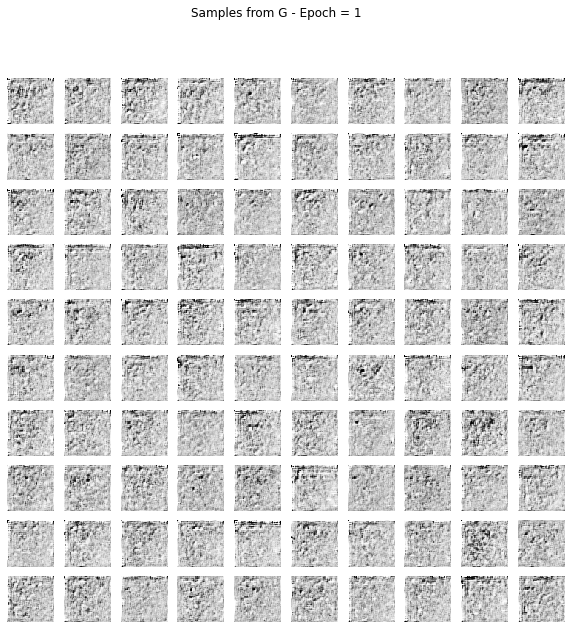

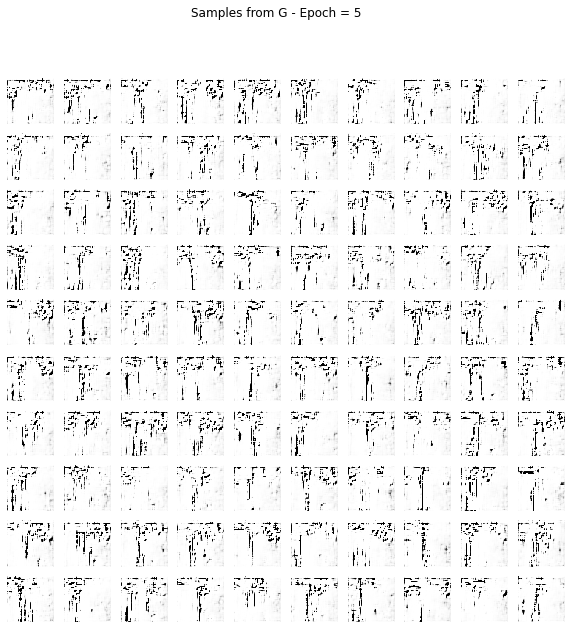

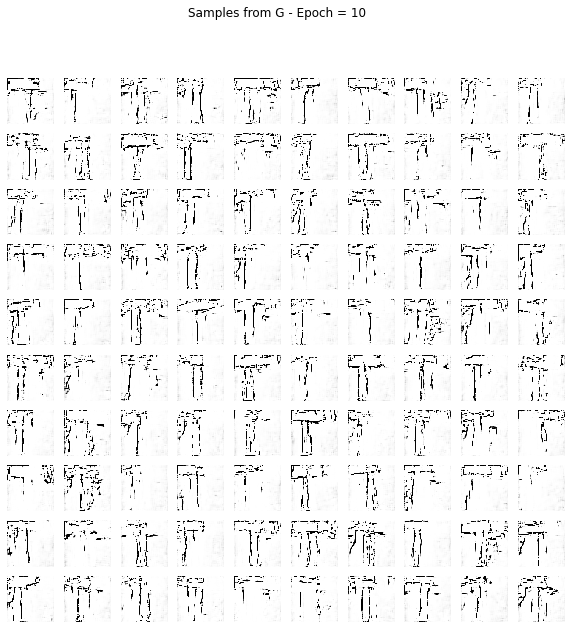

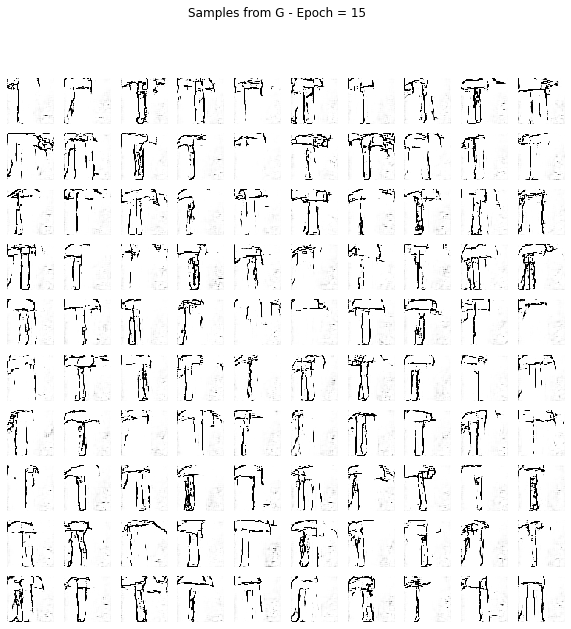

...

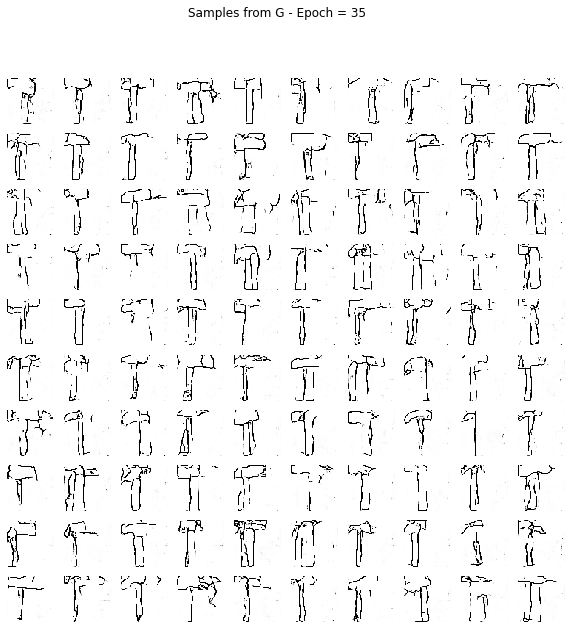

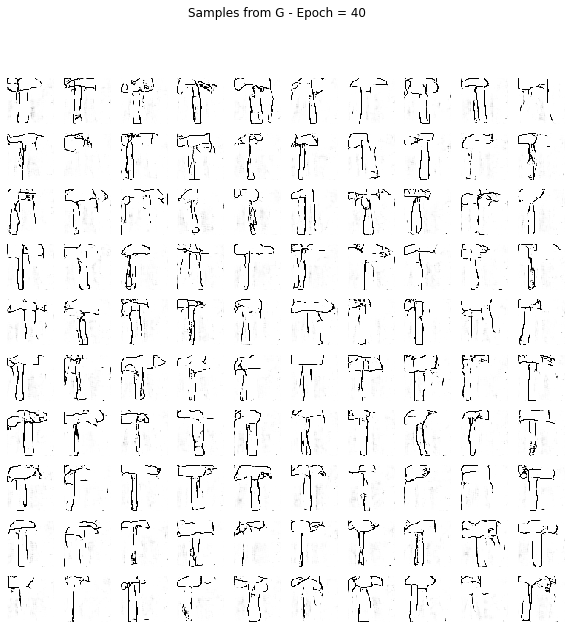

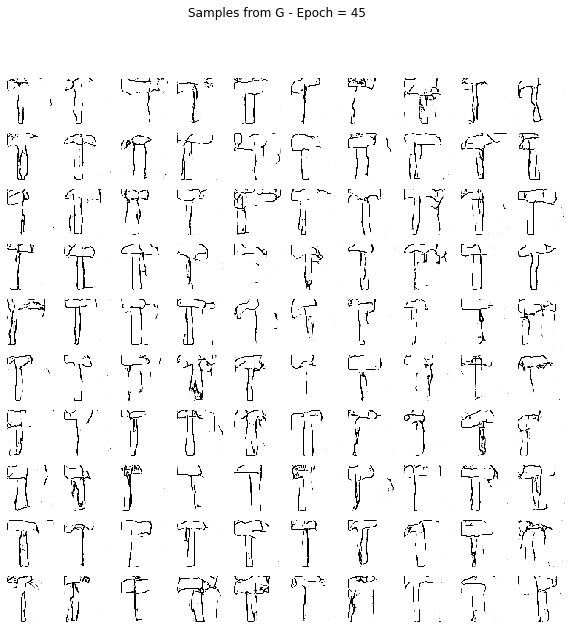

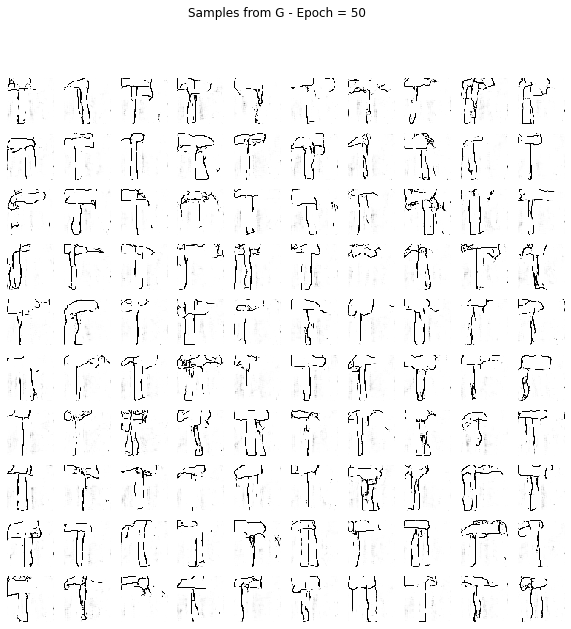

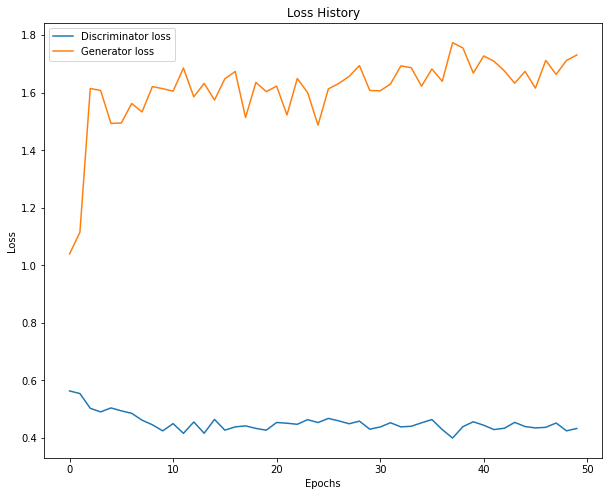

hammer
fail
fail
hammer tree ear
fail
fail
hammer tree bird
fail
fail
hammer chair door
fail
fail
hammer tree pencil
fail
fail
hammer bird tree
fail
fail
hammer tree airplane
fail
fail
hammer door tree
fail
fail
hammer tree diamond
fail
fail
hammer tree pencil
fail
fail
hammer tree door
fail
fail
hammer door tree
fail
fail
hammer chair ladder
fail
fail
hammer tree ear
fail
fail
hammer tree bird
fail
fail
hammer tree pencil
fail
fail
hammer pencil tree
fail
fail
hammer door pencil
fail
fail
hammer tree ear
fail
fail
hammer pencil computer
fail
fail
hammer bird ear
fail
fail
hammer tree chair
fail
fail
hammer door tree
fail
fail
hammer tree chair
fail
fail
hammer tree bird
fail
fail
hammer tree airplane
fail
fail
hammer tree bird
fail
fail
hammer tree chair
fail
fail
hammer ladder bird
fail
fail
hammer tree ladder
fail
fail
hammer pencil sword
fail
fail
hammer tree chair
fail
fail
hammer tree ear
fail
fail
hammer tree door
fail
fail
hammer chair tree
fail
fail
hammer door tree
fail
fail


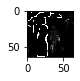

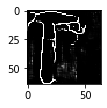

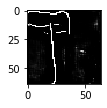

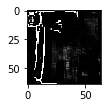

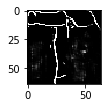

...

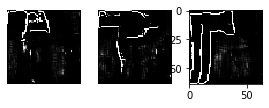

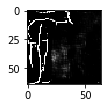

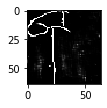

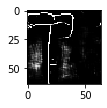

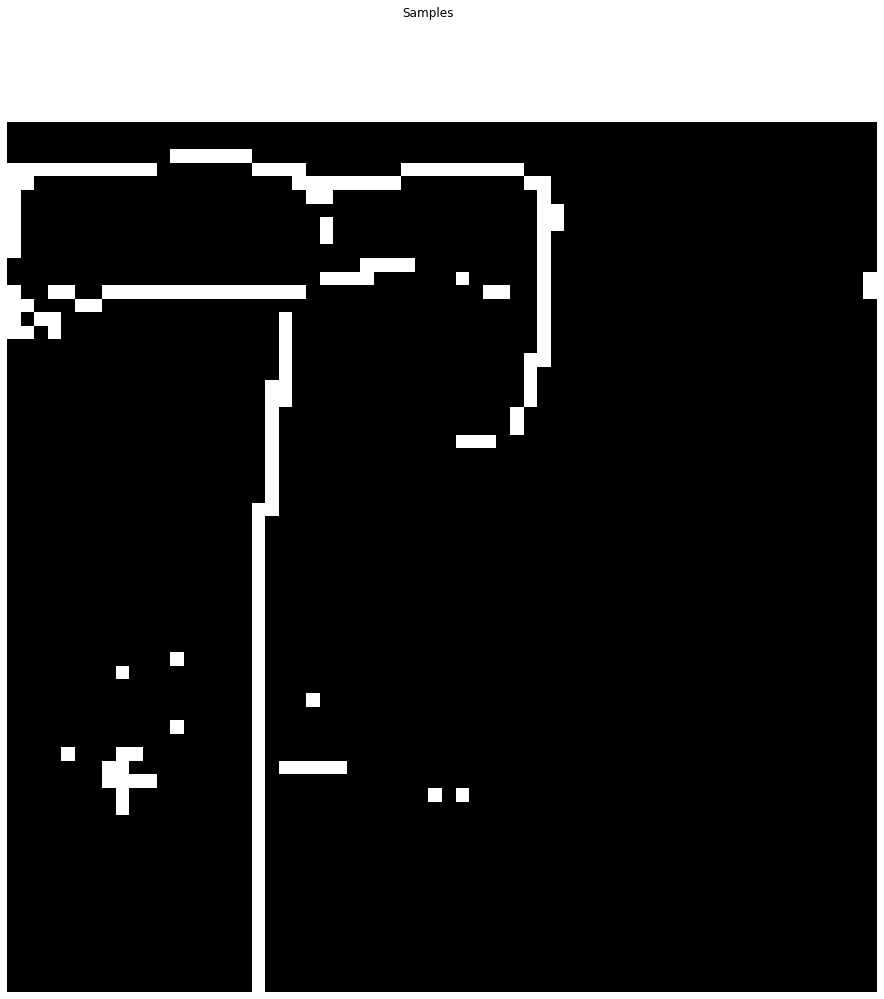

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_30 (Conv2D)           (None, 32, 32, 64)        1664      
_________________________________________________________________
leaky_re_lu_25 (LeakyReLU)   (None, 32, 32, 64)        0         
_________________________________________________________________
dropout_15 (Dropout)         (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_31 (Conv2D)           (None, 16, 16, 128)       204928    
_________________________________________________________________
leaky_re_lu_26 (LeakyReLU)   (None, 16, 16, 128)       0         
_________________________________________________________________
dropout_16 (Dropout)         (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_32 (Conv2D)           (None, 8, 8, 256)       

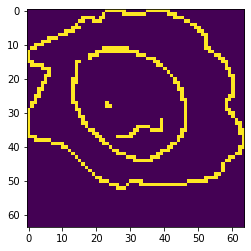

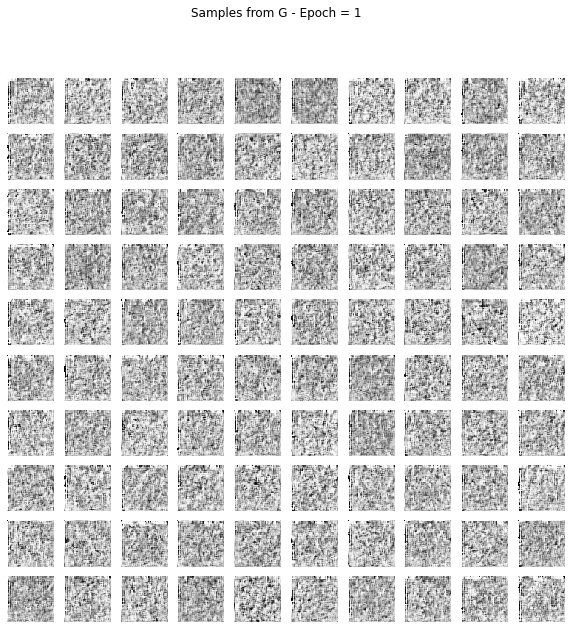

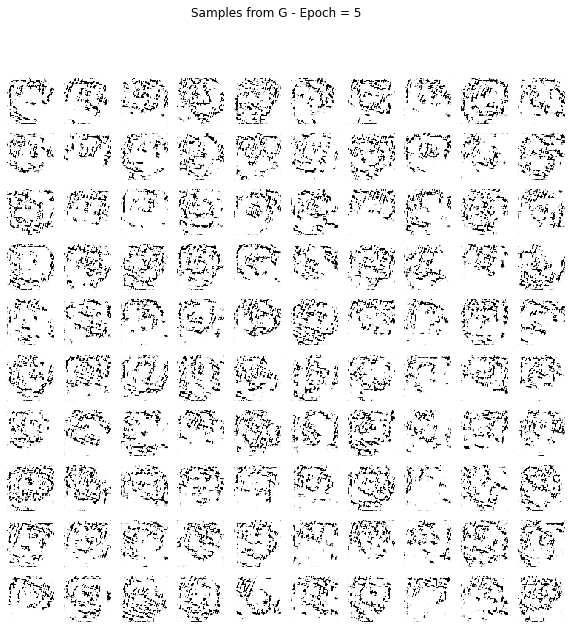

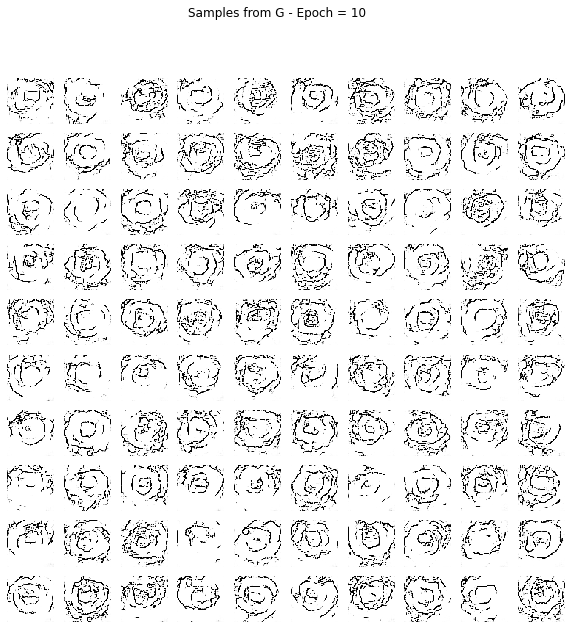

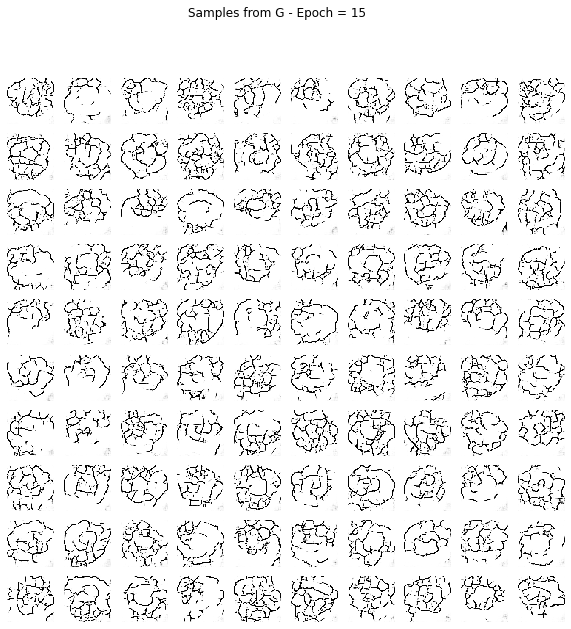

...

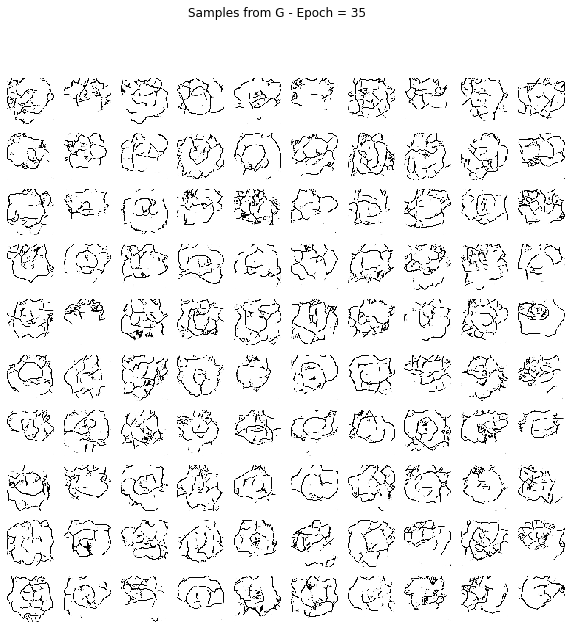

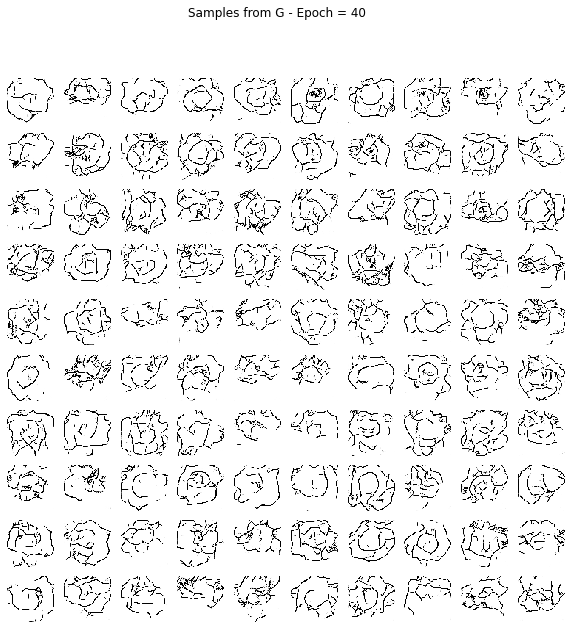

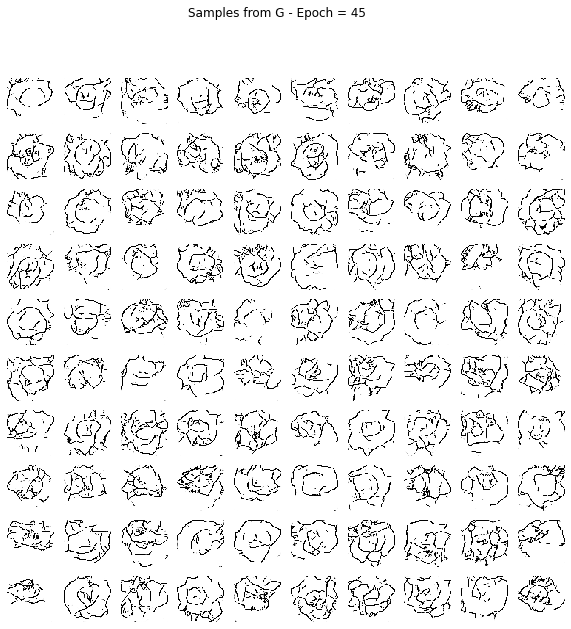

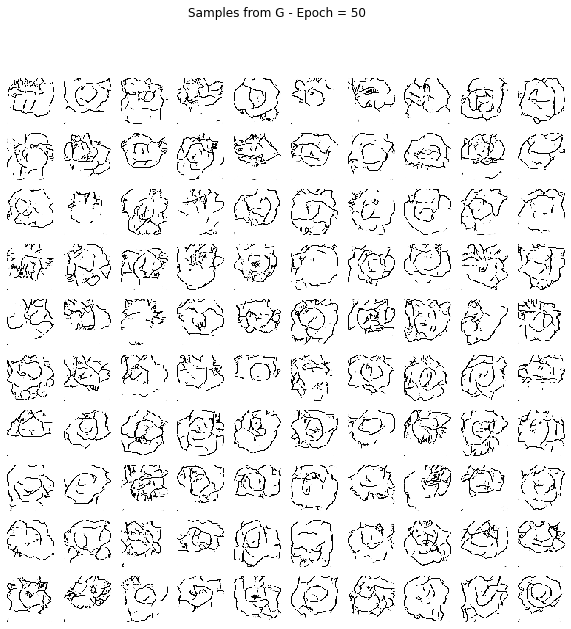

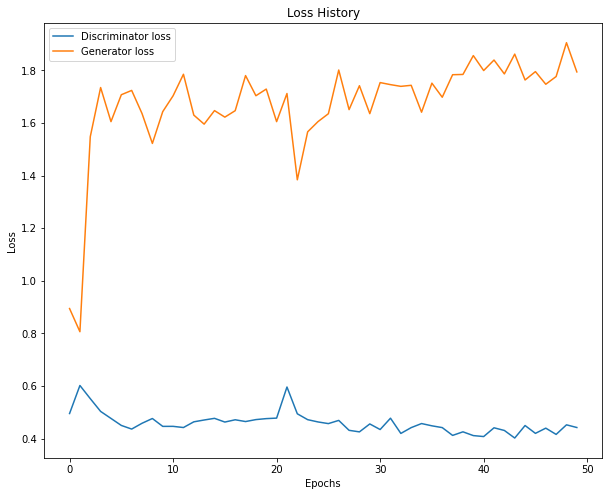

lion
fail
fail
lion cat bird
fail
fail
lion cat bird
fail
fail
lion cat rabbit
fail
fail
lion cat bird
fail
fail
lion cat bird
fail
fail
lion cat clock
fail
fail
lion cat bird
fail
fail
lion cat bird
fail
fail
lion computer bird
fail
fail
lion cat bee
fail
fail
lion cat rabbit
fail
fail
lion cat bird
fail
fail
lion bird cat
fail
fail
lion ear bird
fail
fail
lion cat cake
fail
fail
lion cat bird
fail
fail
lion bird cat
fail
fail
lion cat bird
fail
fail
lion cat bird
fail
fail
lion bird cat
fail
fail
lion bird tree
fail
fail
lion cat bird
fail
fail
lion cat bird
fail
fail
lion cat bird
fail
fail
lion bird bee
fail
fail
lion cat hamburger
fail
fail
lion clock camera
fail
fail
lion cat tree
fail
fail
lion cat bird
fail
fail
lion cat bird
fail
fail
lion bird cat
fail
fail
lion bird cat
fail
fail
lion diamond bird
fail
fail
lion bird cat
fail
fail
lion cat diamond
fail
fail
lion cat clock
fail
fail
lion cat bird
fail
fail
lion clock ear
fail
fail
lion cat bird
fail
fail
lion cat bird
fail
fa

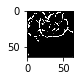

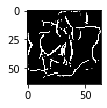

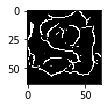

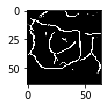

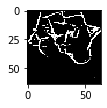

...

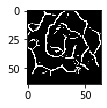

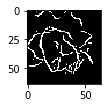

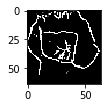

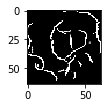

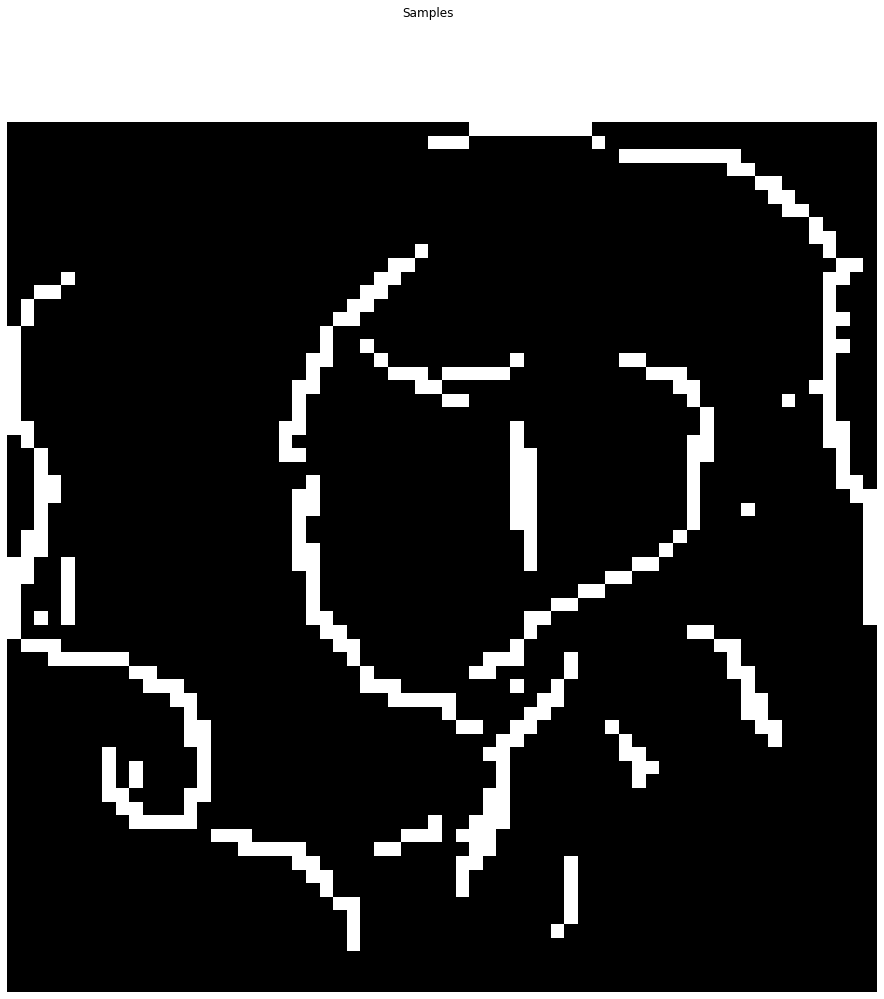

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_36 (Conv2D)           (None, 32, 32, 64)        1664      
_________________________________________________________________
leaky_re_lu_30 (LeakyReLU)   (None, 32, 32, 64)        0         
_________________________________________________________________
dropout_18 (Dropout)         (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_37 (Conv2D)           (None, 16, 16, 128)       204928    
_________________________________________________________________
leaky_re_lu_31 (LeakyReLU)   (None, 16, 16, 128)       0         
_________________________________________________________________
dropout_19 (Dropout)         (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_38 (Conv2D)           (None, 8, 8, 256)       

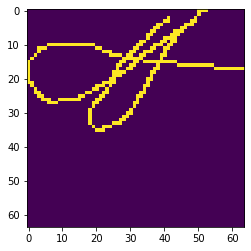

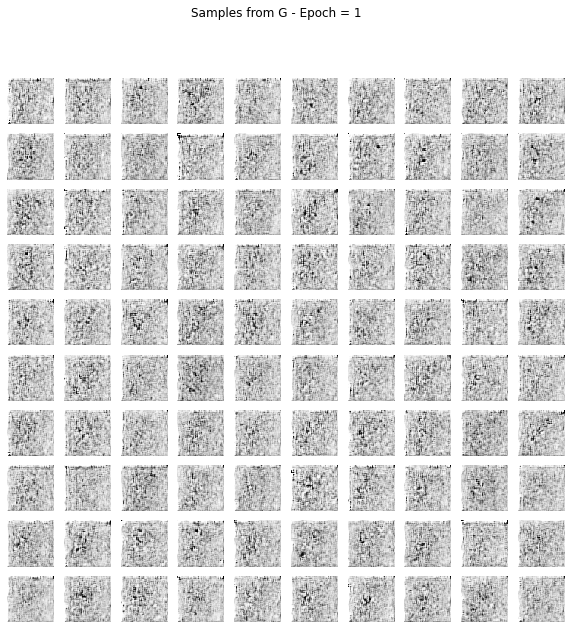

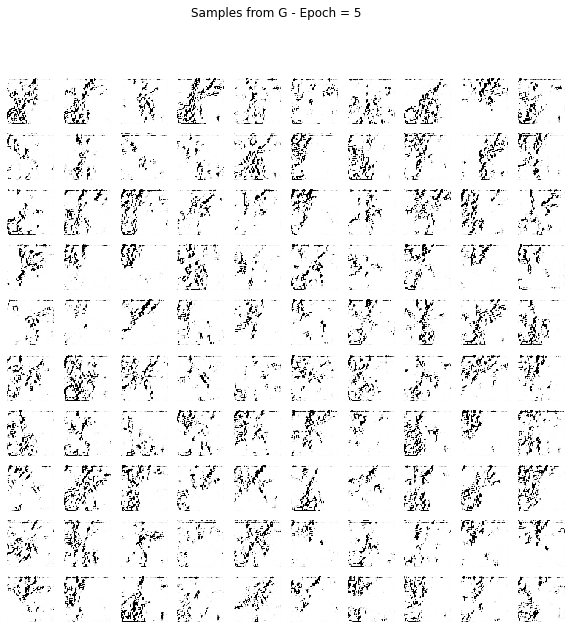

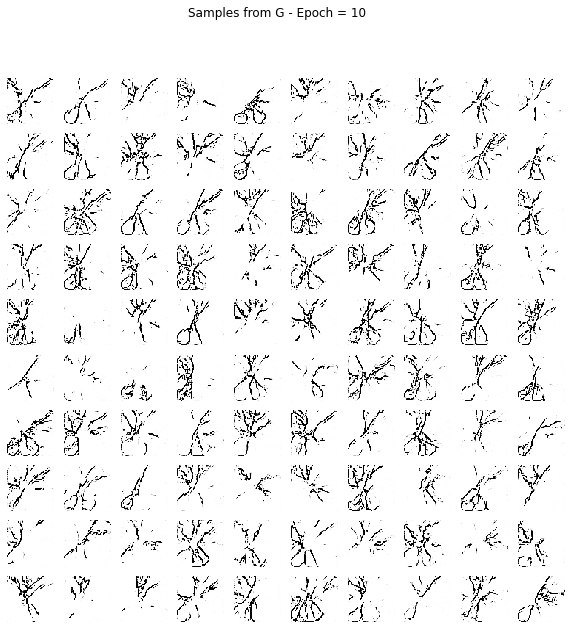

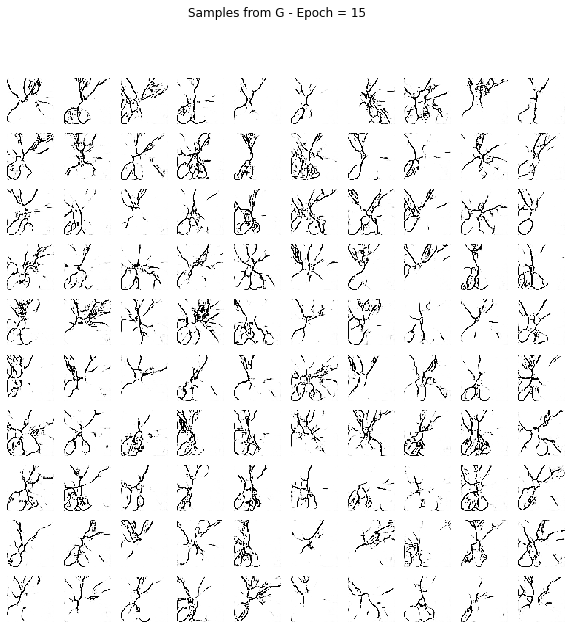

...

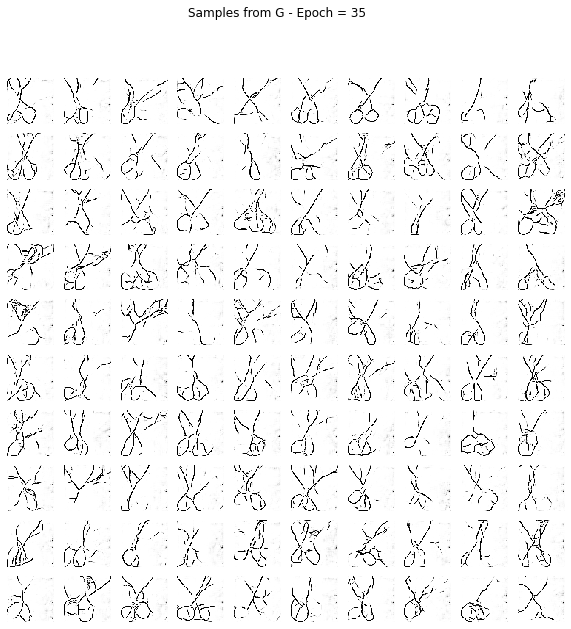

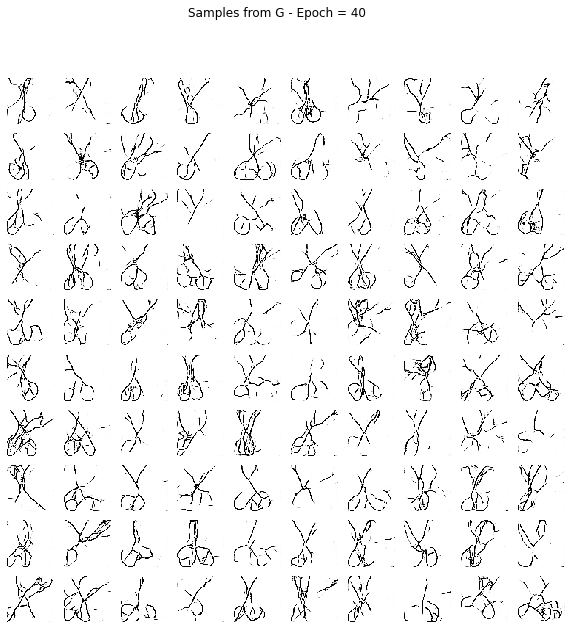

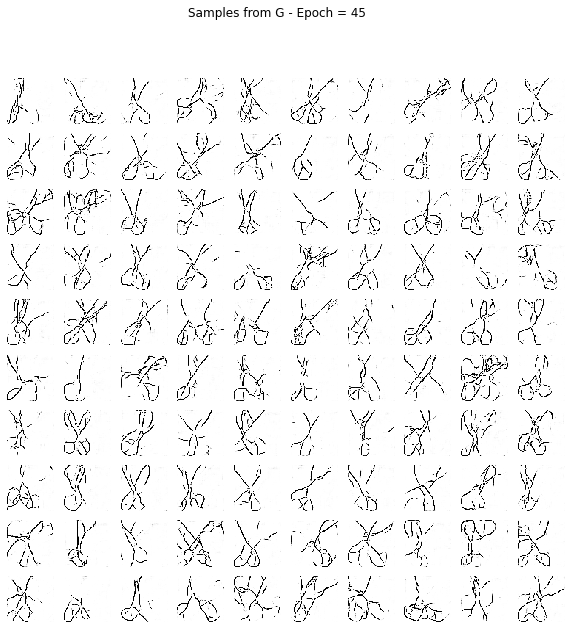

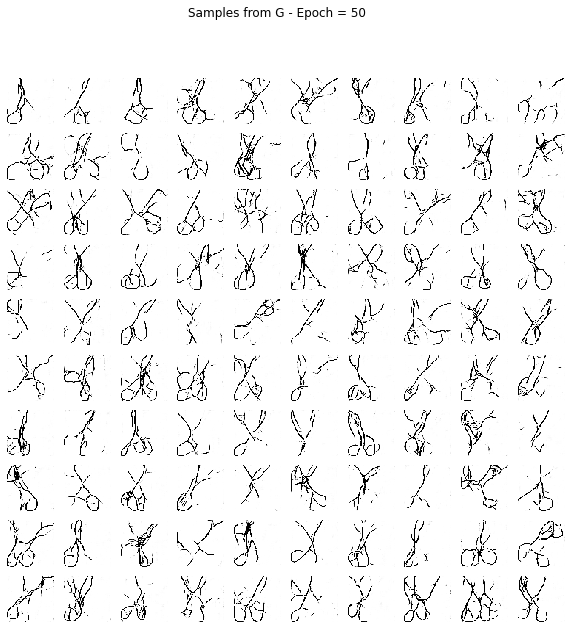

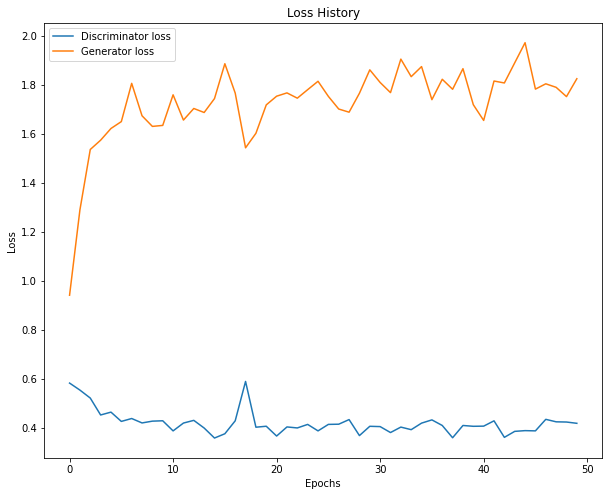

scissors
fail
fail
bird scissors rabbit
fail
fail
scissors star diamond
fail
fail
bird sword star
fail
fail
bee butterfly bicycle
fail
fail
scissors bicycle hammer
fail
fail
scissors butterfly rabbit
fail
fail
bicycle scissors bee
fail
fail
scissors butterfly rabbit
fail
fail
scissors chair guitar
fail
fail
butterfly scissors bee
fail
fail
bird tree leaf
fail
fail
cat bird bee
fail
fail
rabbit cat leaf
fail
fail
bicycle scissors bee
fail
fail
guitar bicycle bird
fail
fail
scissors star ladder
fail
fail
scissors bird guitar
fail
fail
cat bird bicycle
fail
fail
scissors sword guitar
fail
fail
scissors guitar butterfly
fail
fail
bird rabbit scissors
fail
fail
scissors butterfly guitar
fail
fail
guitar scissors butterfly
fail
fail
scissors guitar rabbit
fail
fail
rabbit scissors guitar
fail
fail
scissors butterfly bee
fail
fail
bird cat tree
fail
fail
scissors rabbit hand
fail
fail
scissors guitar sword
fail
fail
cat bird rabbit
fail
fail
scissors sword rabbit
fail
fail
rabbit scissors lad

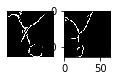

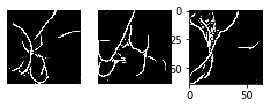

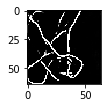

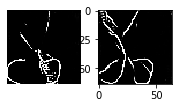

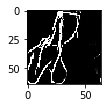

...

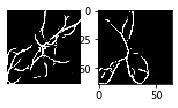

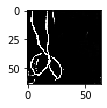

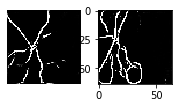

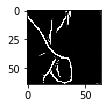

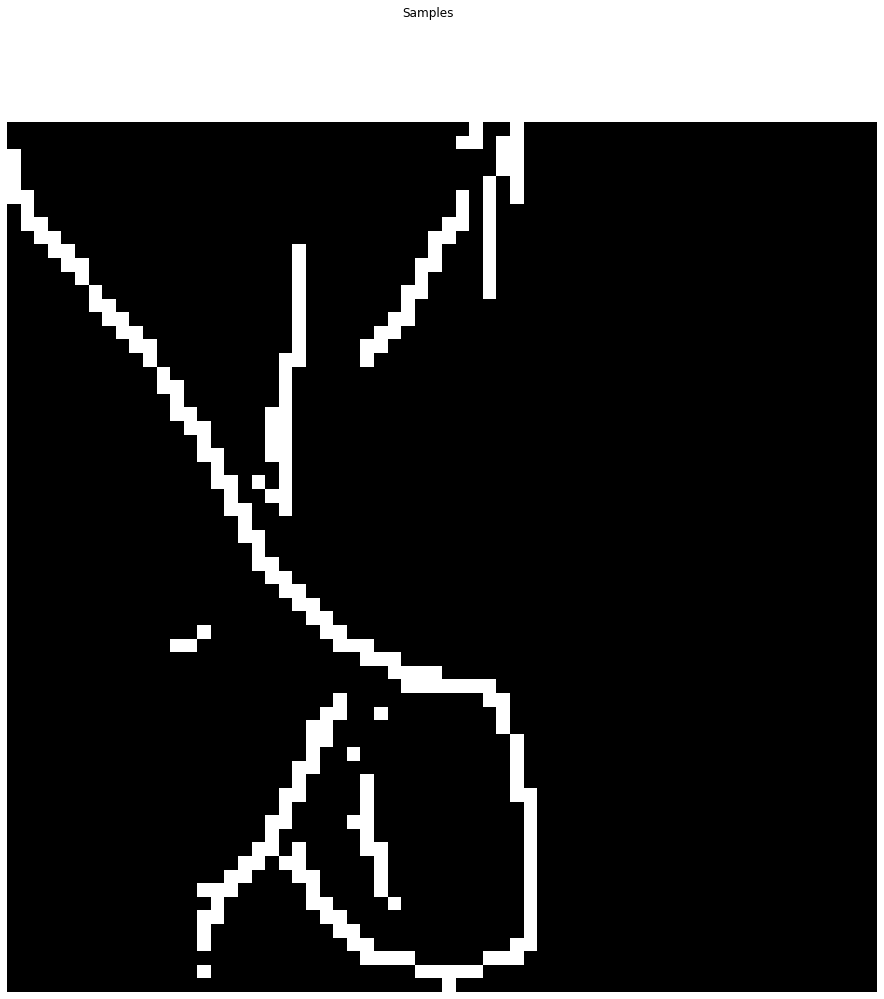

Model: "sequential_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_42 (Conv2D)           (None, 32, 32, 64)        1664      
_________________________________________________________________
leaky_re_lu_35 (LeakyReLU)   (None, 32, 32, 64)        0         
_________________________________________________________________
dropout_21 (Dropout)         (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_43 (Conv2D)           (None, 16, 16, 128)       204928    
_________________________________________________________________
leaky_re_lu_36 (LeakyReLU)   (None, 16, 16, 128)       0         
_________________________________________________________________
dropout_22 (Dropout)         (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_44 (Conv2D)           (None, 8, 8, 256)       

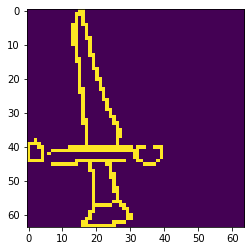

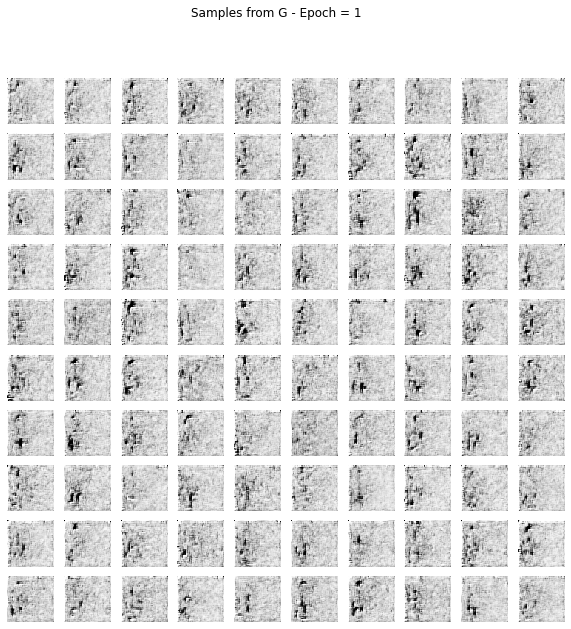

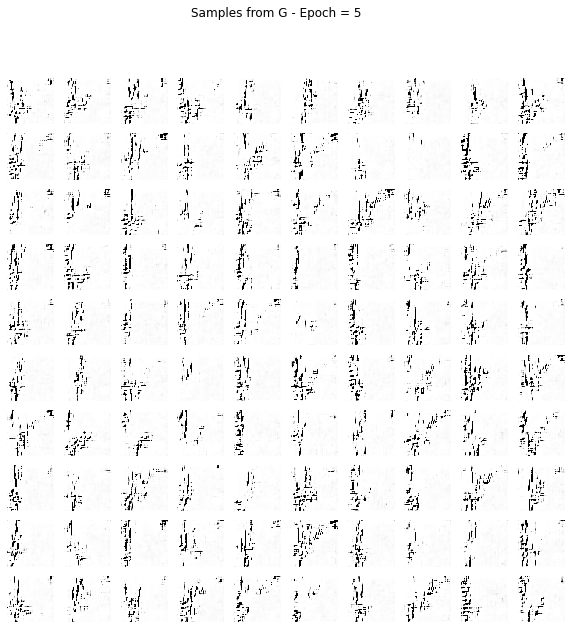

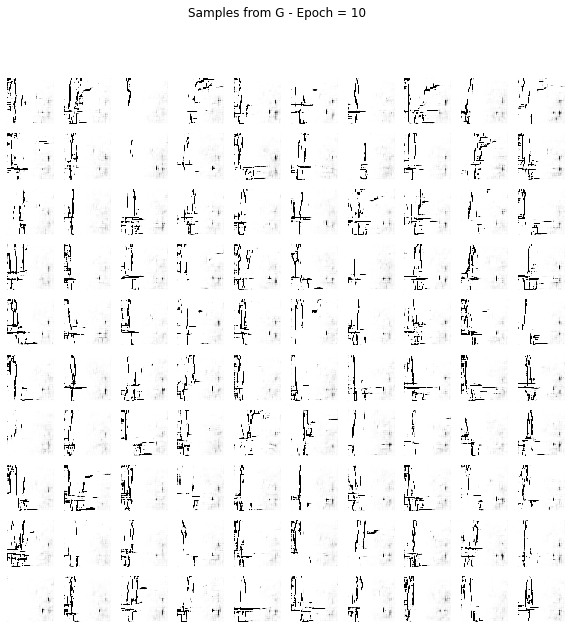

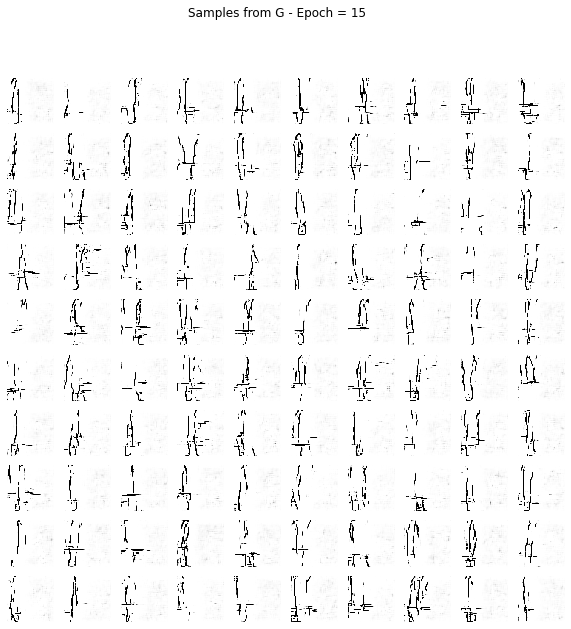

...

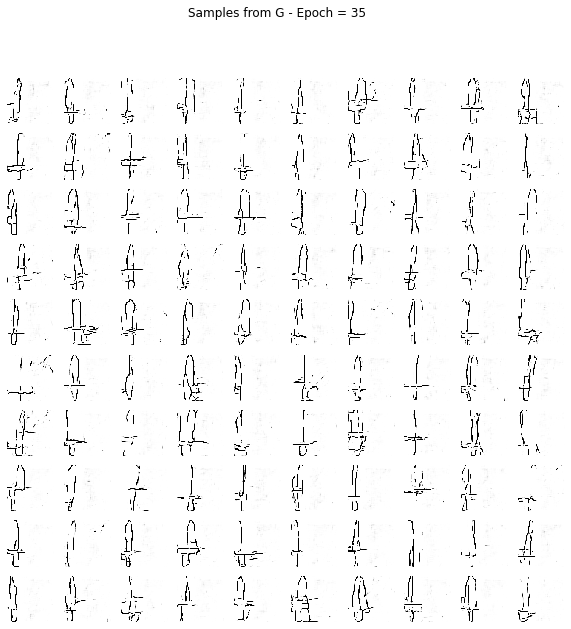

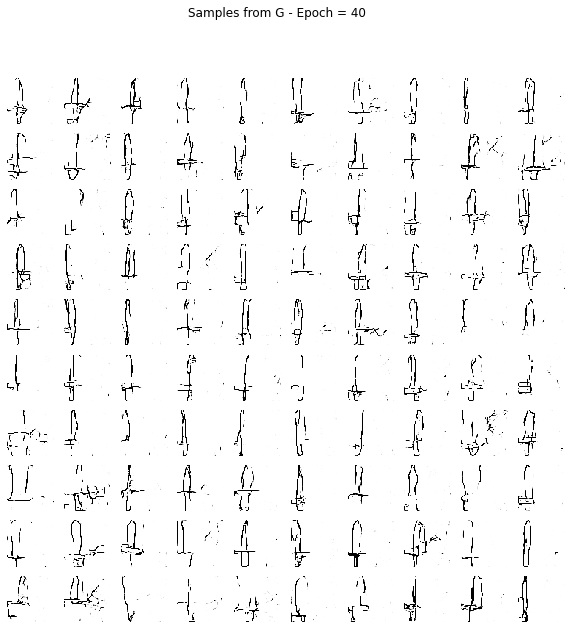

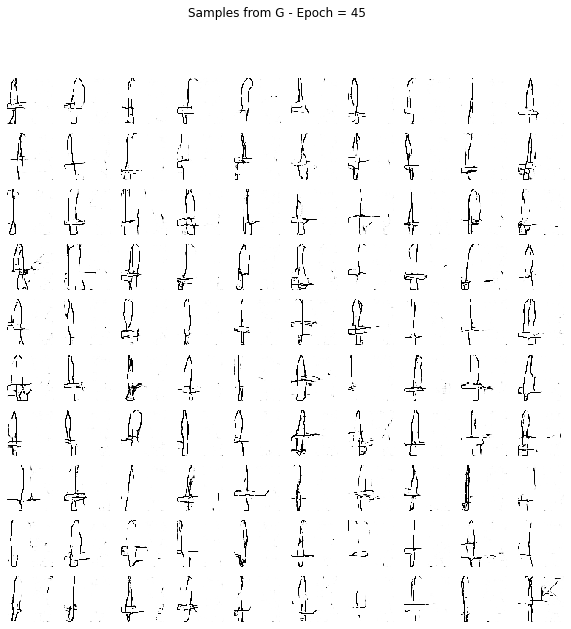

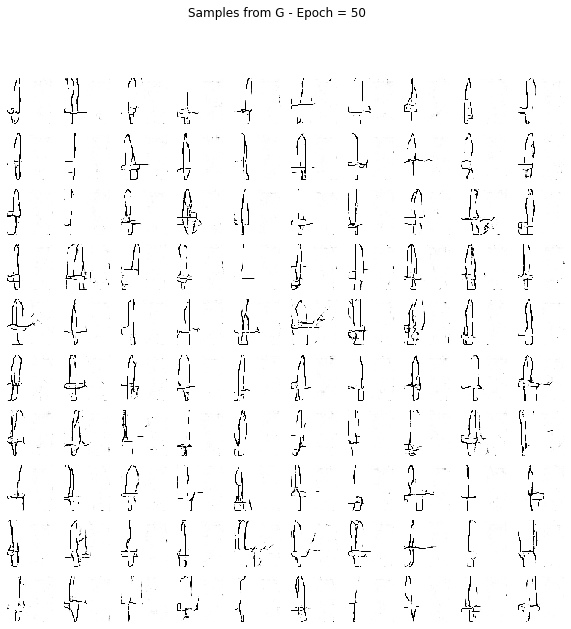

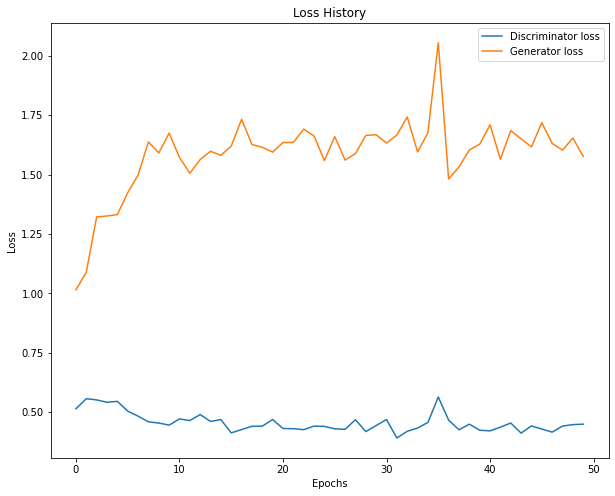

sword
fail
fail
sword pencil rabbit
fail
fail
sword leaf rabbit
fail
fail
sword chair ladder
fail
fail
sword hat pencil
fail
fail
sword ladder hat
fail
fail
sword chair The_Eiffel_Tower
fail
fail
sword leaf pencil
fail
fail
pencil sword ladder
fail
fail
sword chair ladder
fail
fail
sword pencil hat
fail
fail
sword The_Eiffel_Tower chair
fail
fail
sword pencil The_Eiffel_Tower
fail
fail
sword rabbit hat
fail
fail
sword chair ladder
fail
fail
sword pencil chair
fail
fail
sword hat chair
fail
fail
sword pencil rabbit
fail
fail
pencil sword ladder
fail
fail
sword hat ladder
fail
fail
sword hat chair
fail
fail
sword The_Eiffel_Tower chair
fail
fail
sword pencil hammer
fail
fail
sword pencil leaf
fail
fail
leaf sword pencil
fail
fail
sword pencil The_Eiffel_Tower
fail
fail
sword pencil rabbit
fail
fail
pencil sword ladder
fail
fail
sword pencil ladder
fail
fail
sword pencil ladder
fail
fail
sword pencil The_Eiffel_Tower
fail
fail
sword pencil hat
fail
fail
sword pencil The_Eiffel_Tower
fail


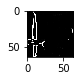

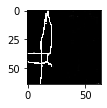

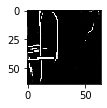

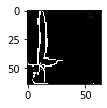

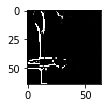

...

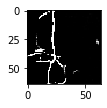

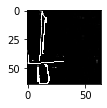

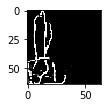

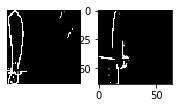

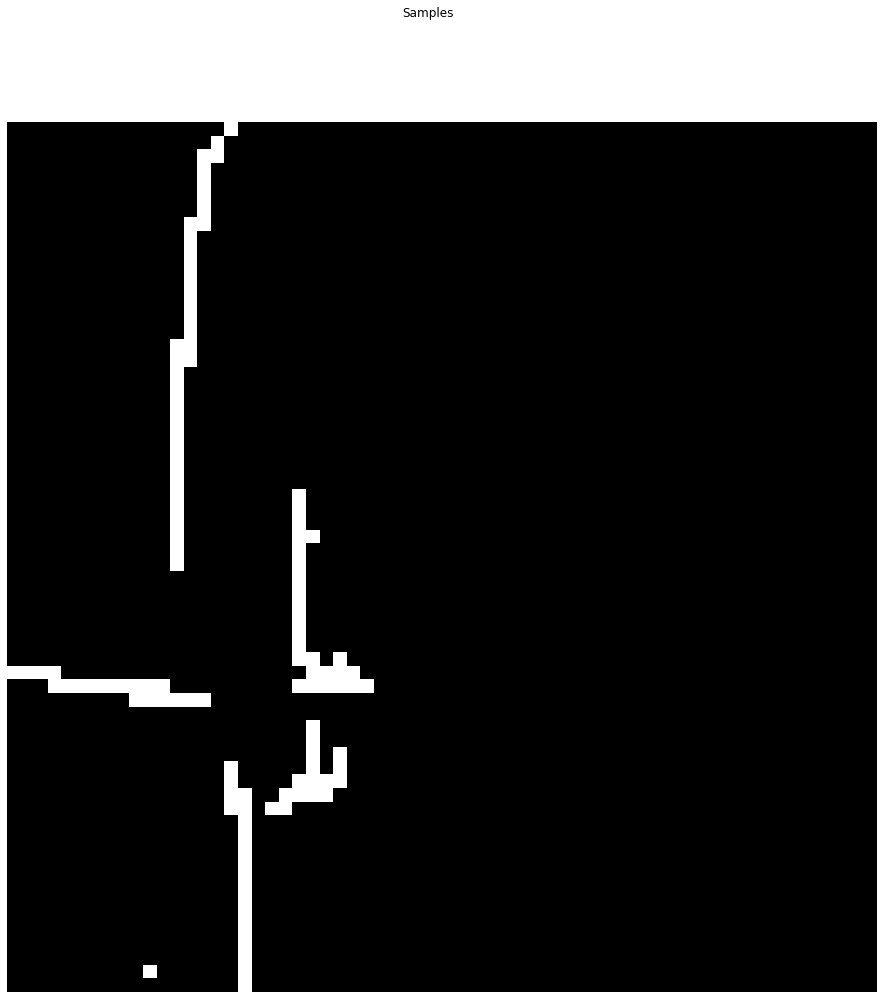

Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_48 (Conv2D)           (None, 32, 32, 64)        1664      
_________________________________________________________________
leaky_re_lu_40 (LeakyReLU)   (None, 32, 32, 64)        0         
_________________________________________________________________
dropout_24 (Dropout)         (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_49 (Conv2D)           (None, 16, 16, 128)       204928    
_________________________________________________________________
leaky_re_lu_41 (LeakyReLU)   (None, 16, 16, 128)       0         
_________________________________________________________________
dropout_25 (Dropout)         (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_50 (Conv2D)           (None, 8, 8, 256)       

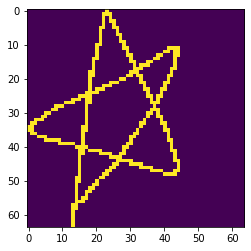

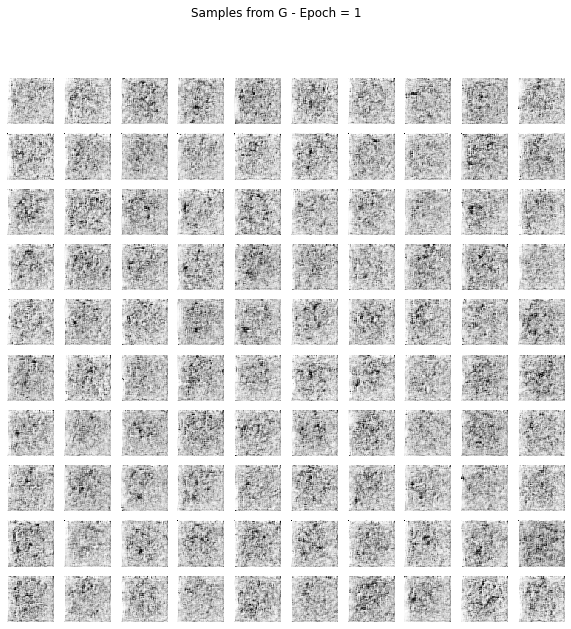

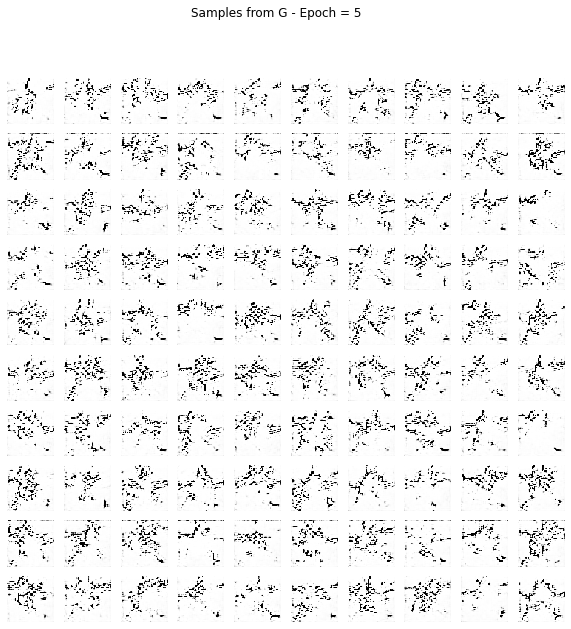

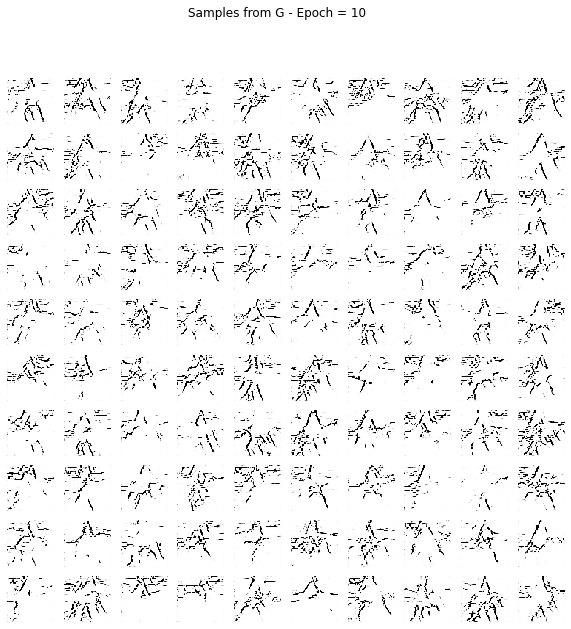

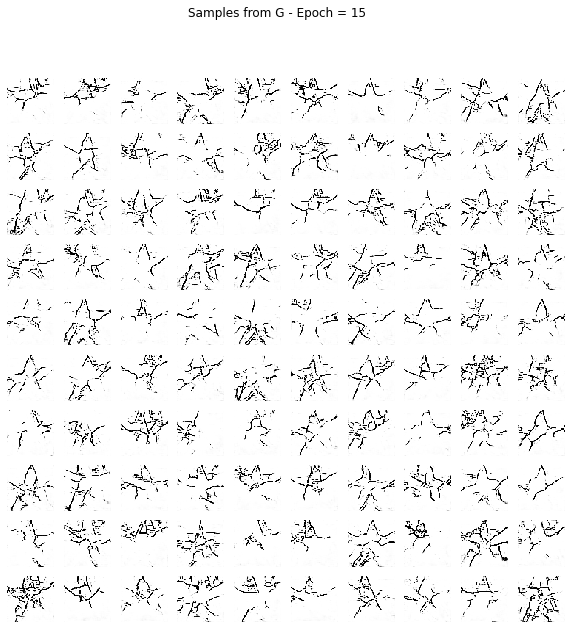

...

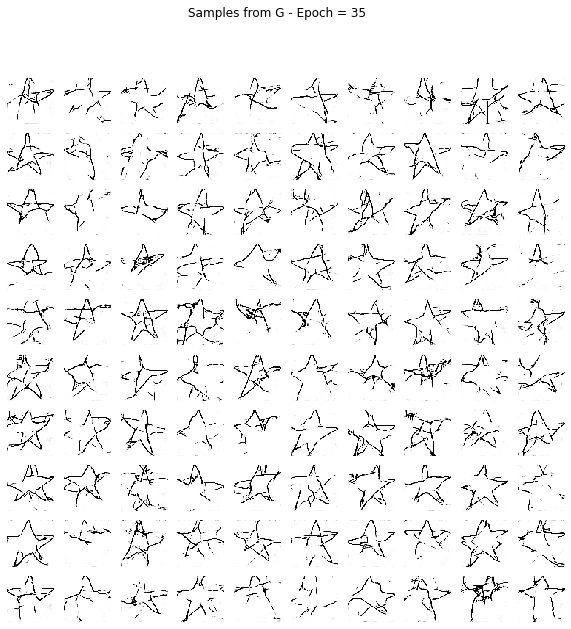

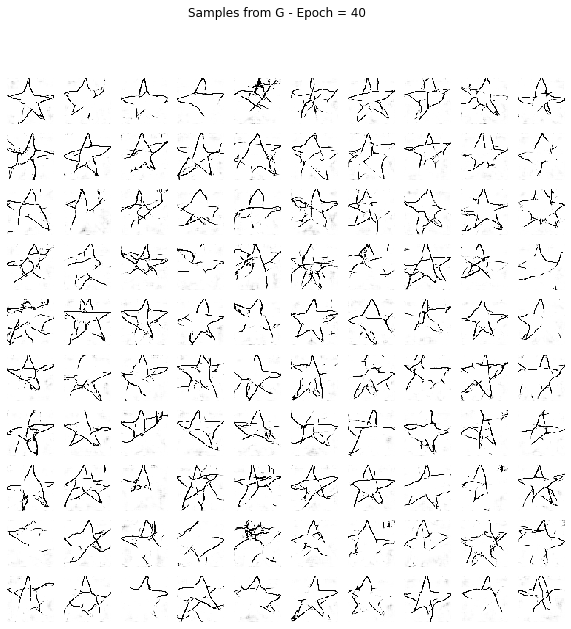

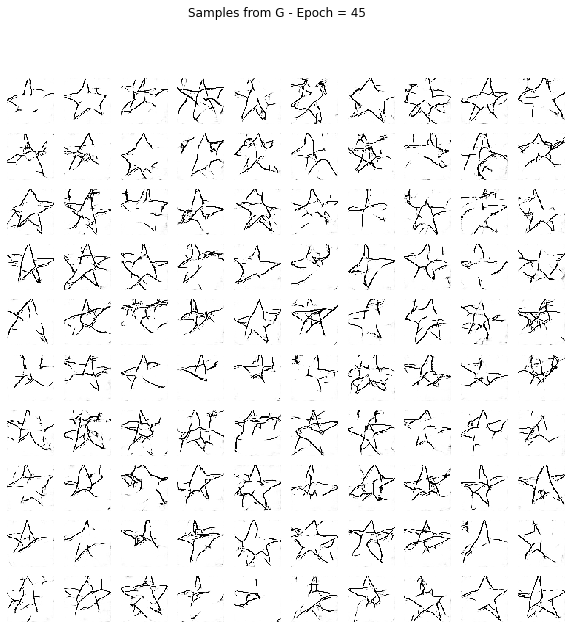

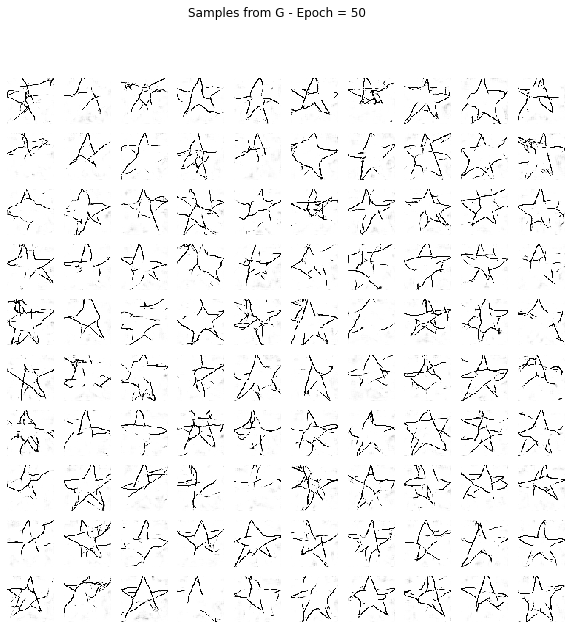

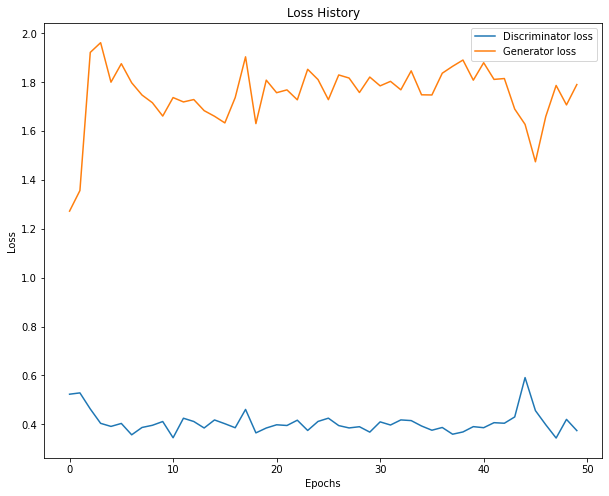

star
fail
fail
airplane cat rabbit
fail
fail
star airplane bird
fail
fail
star airplane The_Eiffel_Tower
fail
fail
star bird airplane
fail
fail
bird star airplane
fail
fail
cat bird airplane
fail
fail
bird star airplane
fail
fail
bird cat star
fail
fail
cat bird bicycle
fail
fail
star bird cat
fail
fail
star bird lion
fail
fail
cat star bird
fail
fail
star airplane cat
fail
fail
star The_Eiffel_Tower bird
fail
fail
star cat lion
fail
fail
star bird lion
fail
fail
star airplane bird
fail
fail
star cat airplane
fail
fail
star sword The_Eiffel_Tower
fail
fail
cat bird star
fail
fail
star airplane bird
fail
fail
star bird butterfly
fail
fail
star lion bird
fail
fail
star bird lion
fail
fail
sword bird airplane
fail
fail
bird star cat
fail
fail
star airplane leaf
fail
fail
star cat airplane
fail
fail
cat bicycle bird
fail
fail
star airplane bird
fail
fail
star bird cat
fail
fail
bird cat star
fail
fail
star airplane bird
fail
fail
cat bird star
fail
fail
star bird cat
fail
fail
star airplan

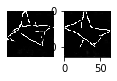

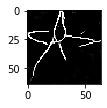

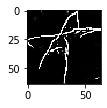

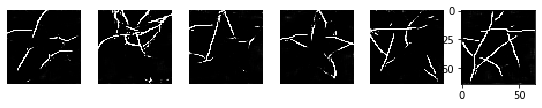

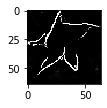

...

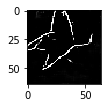

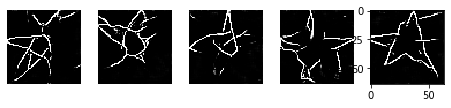

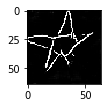

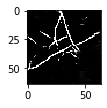

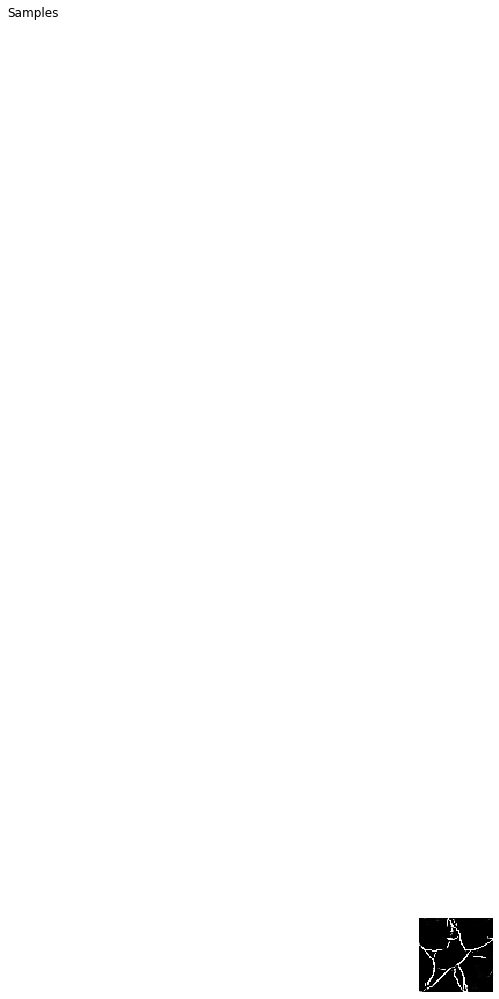

Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_54 (Conv2D)           (None, 32, 32, 64)        1664      
_________________________________________________________________
leaky_re_lu_45 (LeakyReLU)   (None, 32, 32, 64)        0         
_________________________________________________________________
dropout_27 (Dropout)         (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_55 (Conv2D)           (None, 16, 16, 128)       204928    
_________________________________________________________________
leaky_re_lu_46 (LeakyReLU)   (None, 16, 16, 128)       0         
_________________________________________________________________
dropout_28 (Dropout)         (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_56 (Conv2D)           (None, 8, 8, 256)       

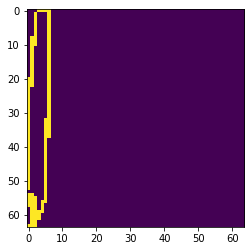

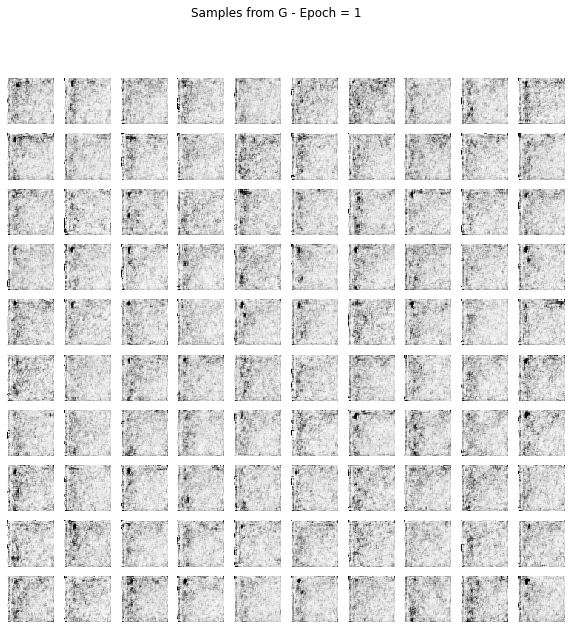

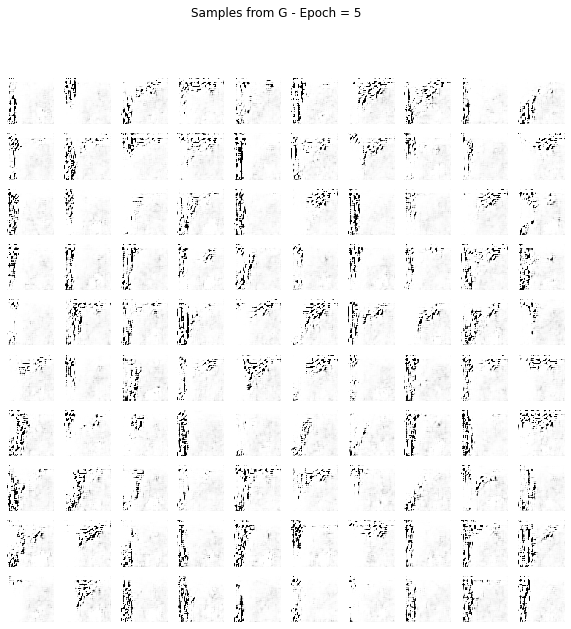

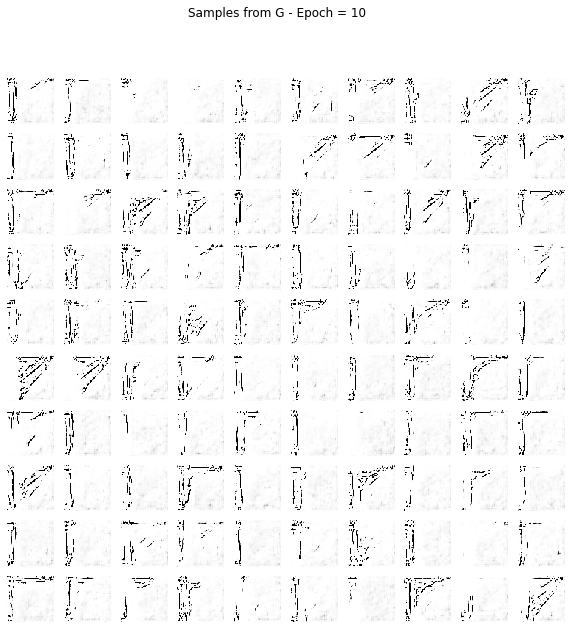

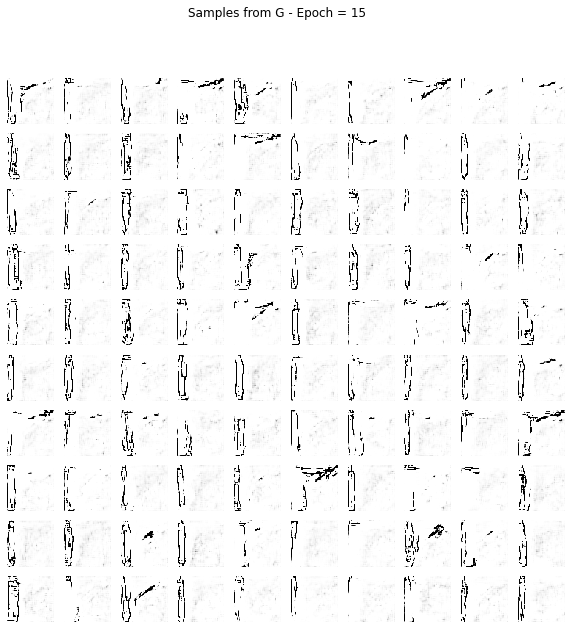

...

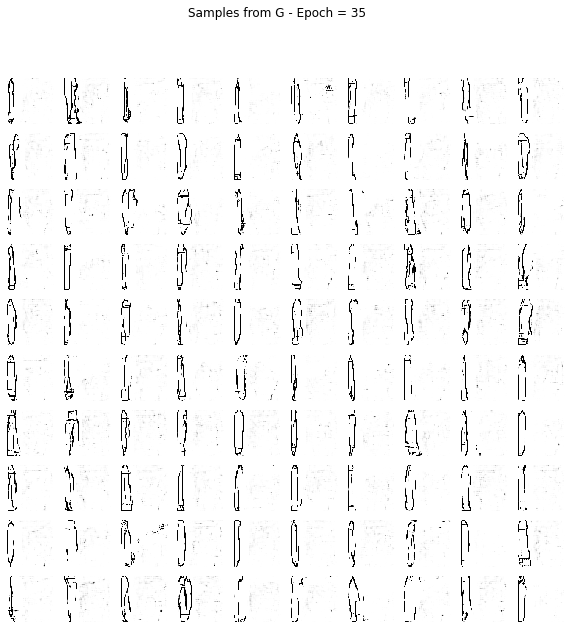

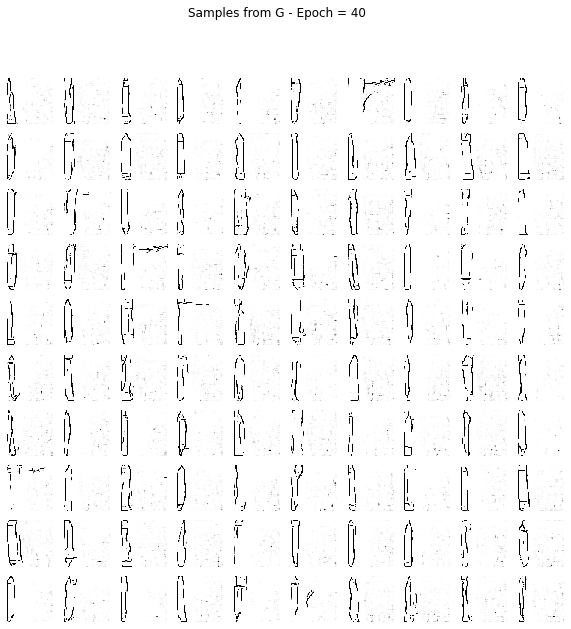

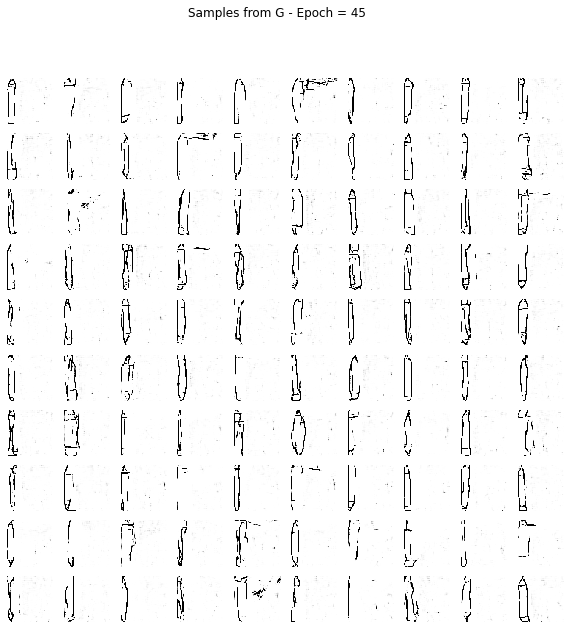

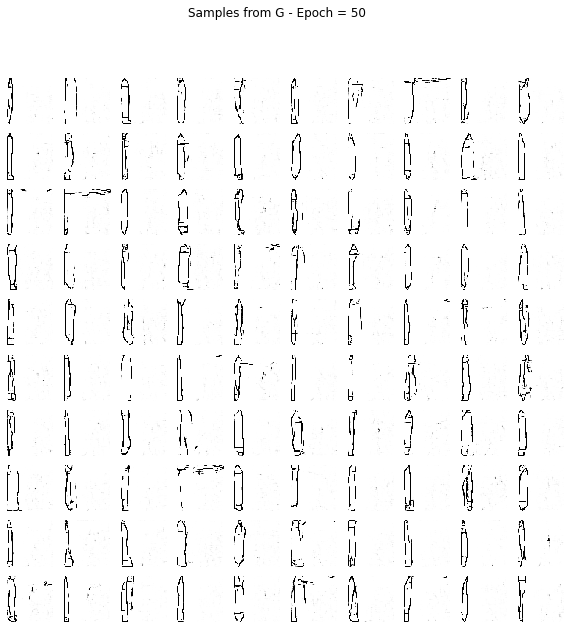

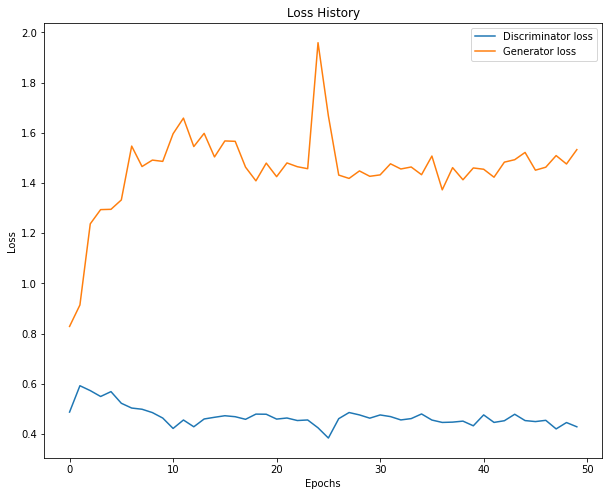

pencil
fail
fail
pencil sword hammer
fail
fail
pencil hammer sword
fail
fail
pencil sword leaf
fail
fail
pencil shoe hat
fail
fail
sword pencil chair
fail
fail
pencil sword leaf
fail
fail
pencil sword hammer
fail
fail
pencil hammer sword
fail
fail
pencil sword hammer
fail
fail
sword pencil chair
fail
fail
pencil sword hammer
fail
fail
pencil sword guitar
fail
fail
pencil sword hammer
fail
fail
pencil sword hammer
fail
fail
hammer door pencil
fail
fail
pencil leaf ladder
fail
fail
pencil sword The_Eiffel_Tower
fail
fail
pencil sword leaf
fail
fail
pencil ladder chair
fail
fail
pencil sword The_Eiffel_Tower
fail
fail
pencil sword ladder
fail
fail
pencil sword hammer
fail
fail
pencil sword hammer
fail
fail
ear pencil hammer
fail
fail
pencil sword leaf
fail
fail
pencil sword hammer
fail
fail
pencil sword The_Eiffel_Tower
fail
fail
pencil sword hammer
fail
fail
pencil sword ladder
fail
fail
pencil hammer ladder
fail
fail
pencil sword guitar
fail
fail
pencil sword ladder
fail
fail
pencil swo

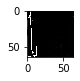

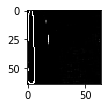

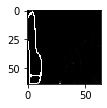

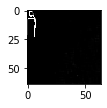

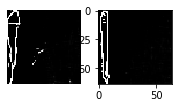

...

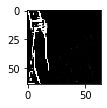

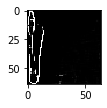

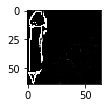

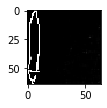

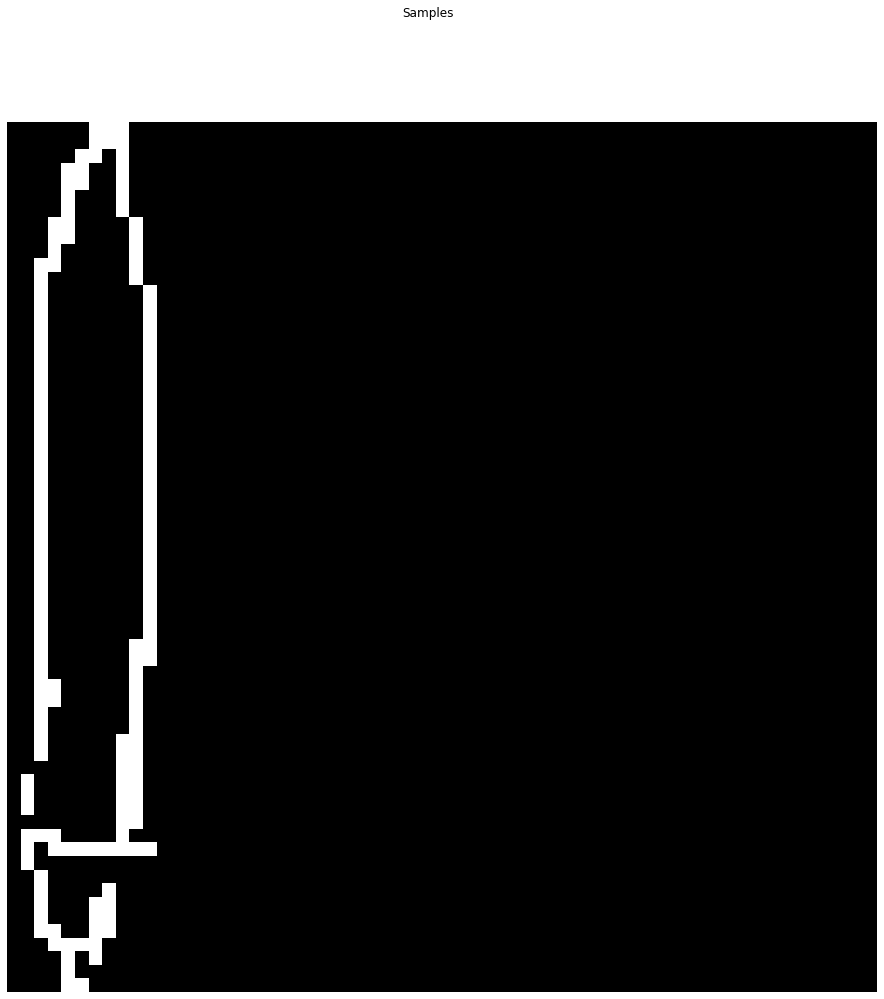

Model: "sequential_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_60 (Conv2D)           (None, 32, 32, 64)        1664      
_________________________________________________________________
leaky_re_lu_50 (LeakyReLU)   (None, 32, 32, 64)        0         
_________________________________________________________________
dropout_30 (Dropout)         (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_61 (Conv2D)           (None, 16, 16, 128)       204928    
_________________________________________________________________
leaky_re_lu_51 (LeakyReLU)   (None, 16, 16, 128)       0         
_________________________________________________________________
dropout_31 (Dropout)         (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_62 (Conv2D)           (None, 8, 8, 256)       

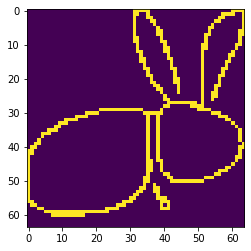

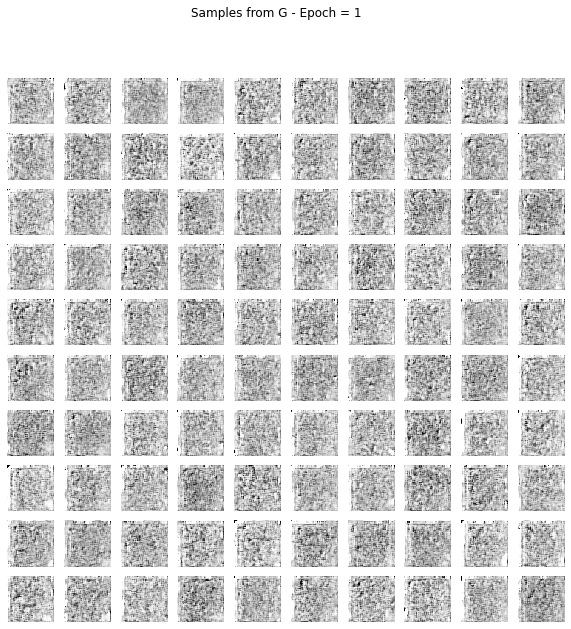

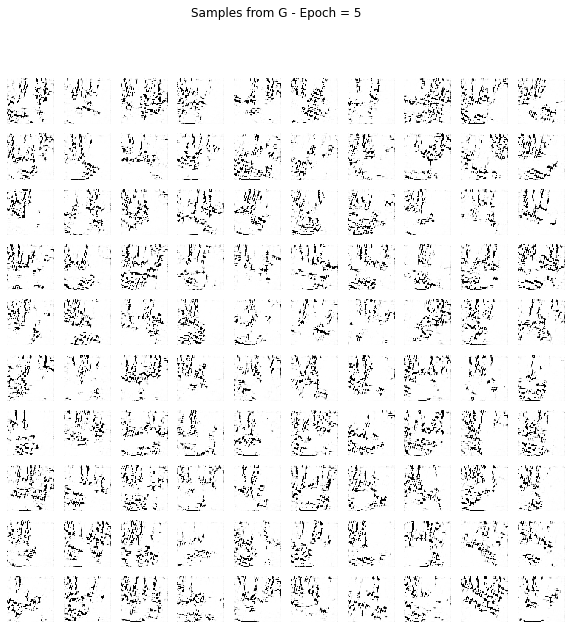

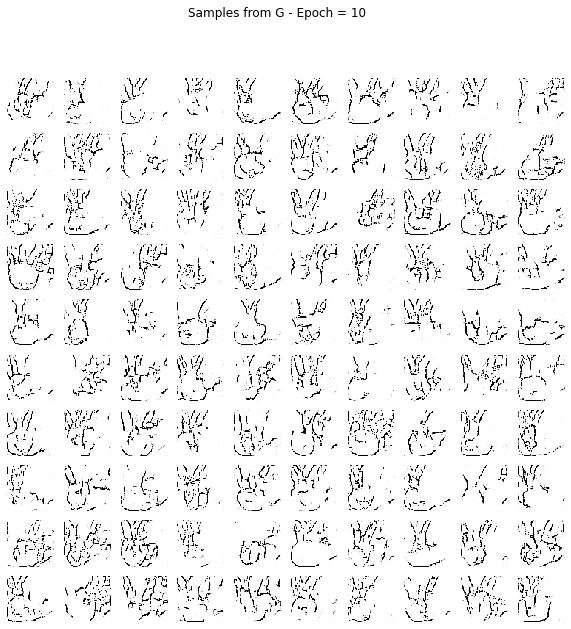

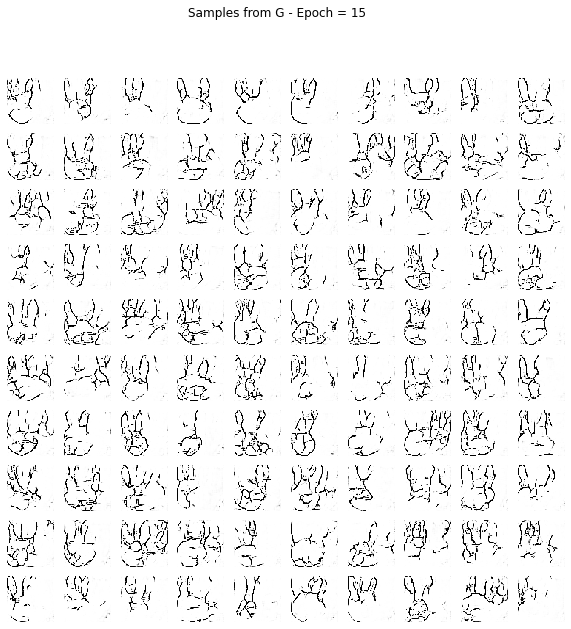

...

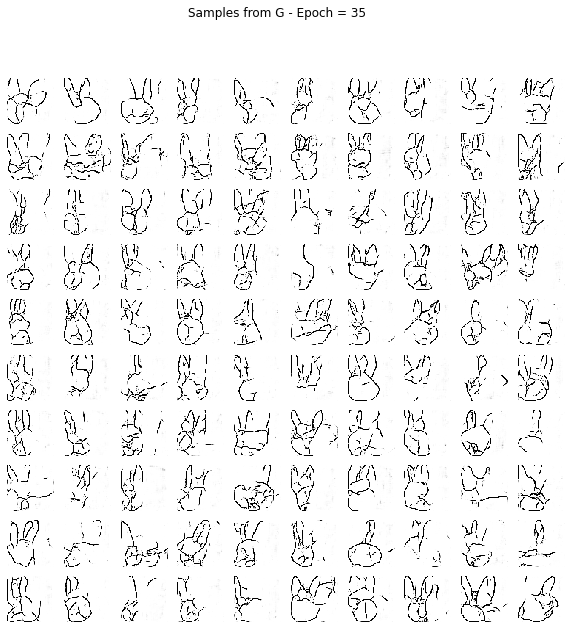

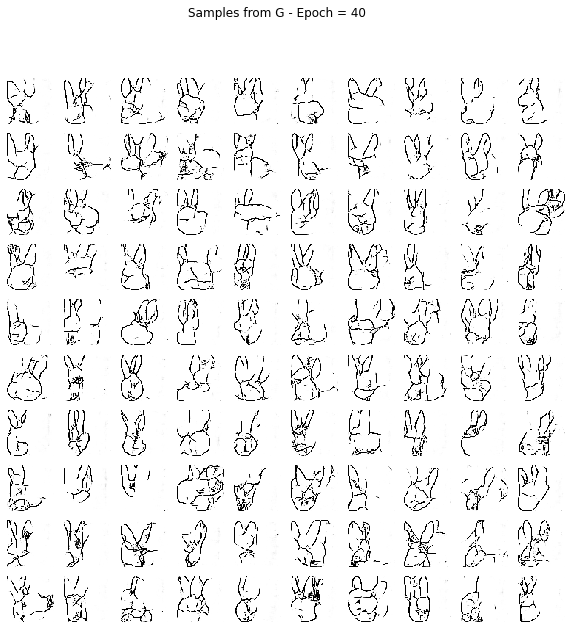

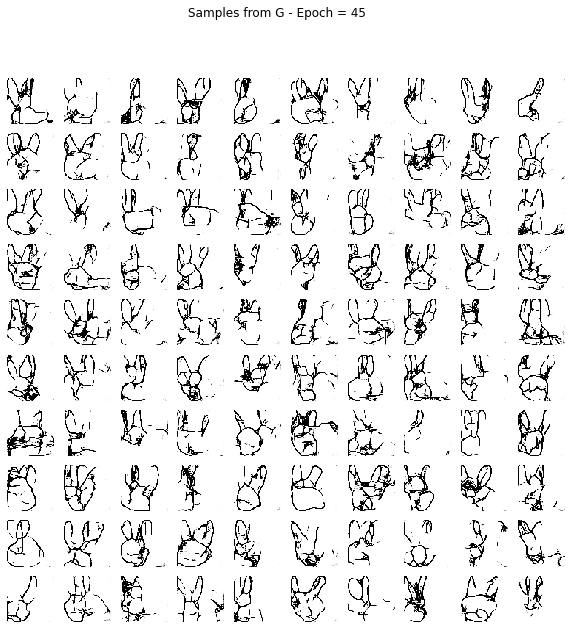

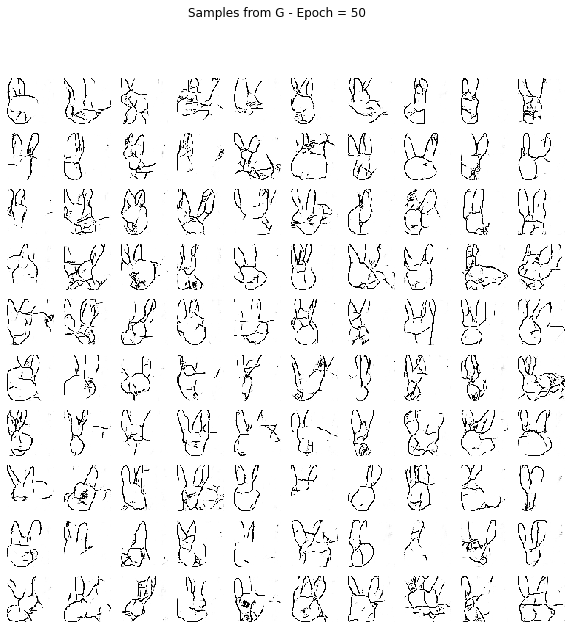

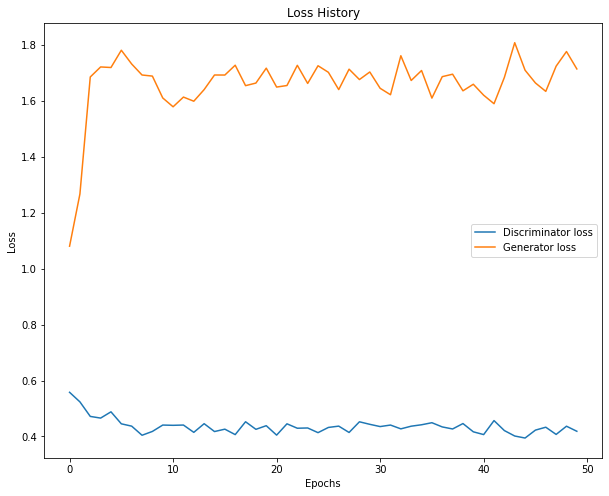

rabbit
fail
fail
cat rabbit bird
fail
fail
guitar cake cat
fail
fail
cat computer rabbit
fail
fail
rabbit cat hand
fail
fail
rabbit hand bee
fail
fail
bird rabbit cat
fail
fail
cat cake rabbit
fail
fail
rabbit bird cat
fail
fail
rabbit bird cat
fail
fail
rabbit guitar cat
fail
fail
rabbit cat bee
fail
fail
rabbit bee bird
fail
fail
rabbit bee bird
fail
fail
rabbit bird cat
fail
fail
rabbit cat cake
fail
fail
rabbit cat bird
fail
fail
bird rabbit airplane
fail
fail
rabbit bird cat
fail
fail
rabbit butterfly ear
fail
fail
rabbit butterfly cat
fail
fail
rabbit cat hand
fail
fail
rabbit cat bird
fail
fail
rabbit cat computer
fail
fail
rabbit cake guitar
fail
fail
guitar leaf rabbit
fail
fail
rabbit bird cat
fail
fail
rabbit cat bird
fail
fail
rabbit cat cake
fail
fail
hand rabbit leaf
fail
fail
cat cake rabbit
fail
fail
rabbit cat bird
fail
fail
rabbit cat bird
fail
fail
cat rabbit leaf
fail
fail
rabbit cat cake
fail
fail
rabbit butterfly hand
fail
fail
rabbit cat hand
fail
fail
rabbit bir

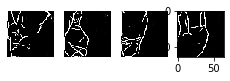

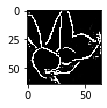

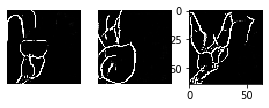

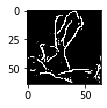

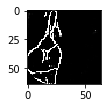

...

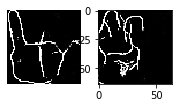

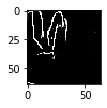

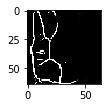

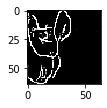

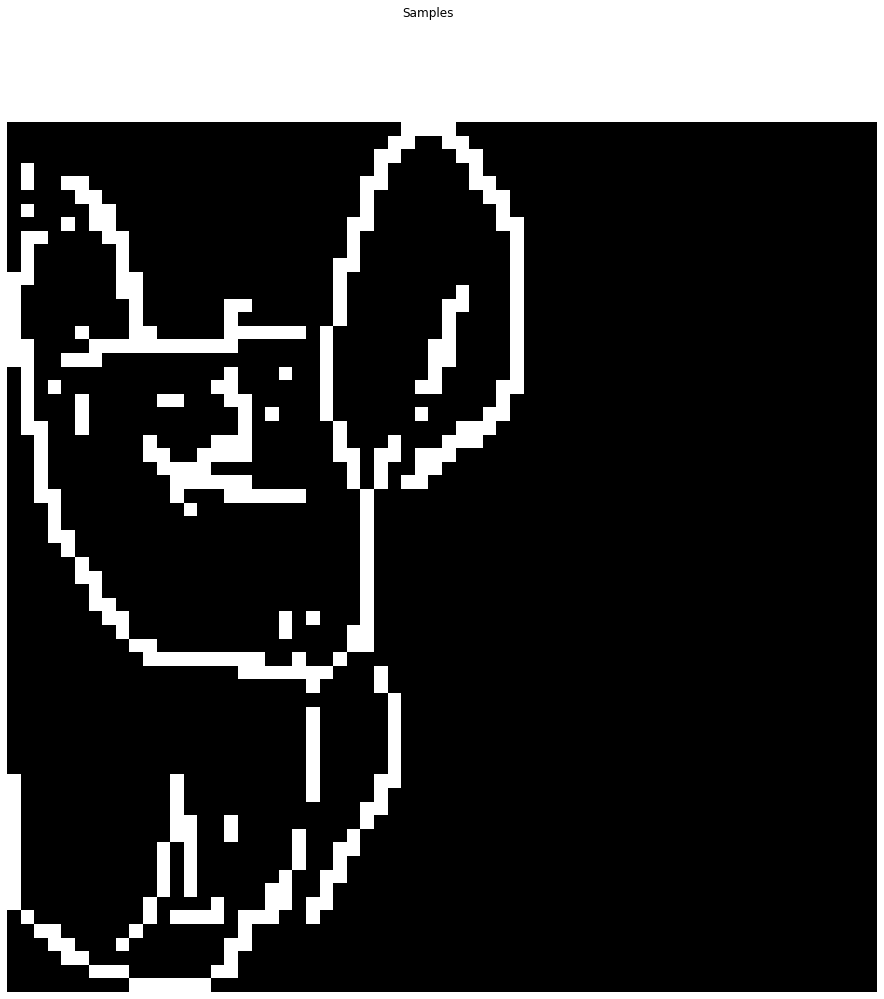

In [ ]:
for image_label in class_paths2:
  num_classes = 30
  imheight, imwidth = 64, 64
  ims_per_class = 10000
  #image_label = "airplane"
  generator_path = "/content/drive/My Drive/AI/output/model/generator/" + image_label + "_generator.h5"
  discriminator_path = "/content/drive/My Drive/AI/output/model/discriminator/" + image_label + "_discriminator.h5"
  generator_test = pd.read_csv("/content/drive/My Drive/AI/input/train/" + image_label + ".csv",nrows=ims_per_class)
  generator_imagebag = bag.from_sequence(generator_test.drawing.values).map(draw_it)
  generator_trainarray = np.array(generator_imagebag.compute())

  generator_X_train = ((generator_trainarray.astype(np.float32)/127.5)) - 1. #normalize to be [-1,1]
  generator_num_train = generator_X_train.shape[0]
  generator_X_train = generator_X_train.reshape(generator_num_train, imheight, imwidth, 1)

  random_test = generator_X_train[np.random.randint(generator_num_train-1)].reshape(64, 64)
  random_test = random_test*127.5 + 1
  plt.imshow(random_test)

  gan = DCGAN()
  gan.train(generator_X_train, epochs=50, batch_size=128, sample_interval=5)

  model_path = "/content/drive/My Drive/AI/output/model/classifier.h5"
  output_csv_dir = "/content/drive/My Drive/AI/output/csv/"
  output_image_dir = "/content/drive/My Drive/AI/output/image/"
  model = keras.models.load_model(model_path, custom_objects={'top_3_accuracy': top_3_accuracy})
  #image_label = "airplane"
  img_h, img_w = 64, 64
  num_examples = 100

  gen_model = keras.models.load_model("/content/drive/My Drive/AI/output/model/generator/"+image_label+ "_generator.h5")

  correct_label = image_label.replace(" ", "_")
  print(correct_label)
  latent_dim = 100
  random_noise = np.random.normal(0, 1, size=[num_examples, latent_dim])
  generator_predictions = gen_model.predict(random_noise)
  generator_predictions = generator_predictions.reshape(num_examples, img_h, img_w)

  plt.figure(figsize=(10, 10))
  correct_count = 0

  for i in range(generator_predictions.shape[0]):
      plt.subplot(10, 10, i+1)
      plt.imshow(generator_predictions[i], interpolation='nearest', cmap='gray')
      grapharray = generator_predictions[i]
      for j in range(64):
          for k in range(64):
              if grapharray[j][k] < 0.2 : grapharray[j][k] = 1.
              else: grapharray[j][k] = 0.

      grapharray = np.reshape(grapharray, (1, 64, 64, 1))
      graphpreds = model.predict(grapharray, verbose=0)
      gvs = np.argsort(-graphpreds)

      try:
        os.mkdir(output_image_dir + image_label)
      except:
        print('fail')
      try:
        os.mkdir(output_csv_dir + image_label)
      except:
        print('fail')


      for idx in gvs[:]:
          print(numstonames[idx[0]], numstonames[idx[1]], numstonames[idx[2]])
          if numstonames[idx[0]] == correct_label :
            correct_count = correct_count + 1
            save_images(grapharray)
      plt.axis('off')

  print("Accuracy = ", correct_count / num_examples)

  plt.suptitle("Samples")
  plt.show()